In [1]:
# @title 1. CÀI ĐẶT THƯ VIỆN & TẢI MÔ HÌNH (Sử dụng Diffusers/ControlNet)
import torch
import os
import cv2
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image

print("--- BẮT ĐẦU CÀI ĐẶT ---")

# Cài đặt thư viện Diffusers và ControlNet Aux (để trích xuất OpenPose)
# Đã thêm lại các lệnh pip install bị thiếu
!pip install diffusers transformers accelerate controlnet_aux opencv-python-headless
print("\nĐã cài đặt Diffusers và ControlNet Aux.")

# Thiết lập thư mục đầu ra
OUTPUT_DIR = "Pro_Auto_Pose_Output"
os.makedirs(OUTPUT_DIR, exist_ok=True)
os.environ['OUTPUT_DIR'] = OUTPUT_DIR

# Tải các thư viện Python sau khi cài đặt thành công
from diffusers import StableDiffusionPipeline, ControlNetModel, UniPCMultistepScheduler
from diffusers.utils import load_image
from controlnet_aux import OpenposeDetector

# Tải mô hình trích xuất OpenPose (Preprocessor)
openpose_detector = OpenposeDetector.from_pretrained("lllyasviel/ControlNet")
print("\nĐã tải mô hình OpenPose Detector (Preprocessor).")

# Tải pipeline Stable Diffusion để tạo ảnh cơ sở (Base Image)
# Kiểm tra GPU và thiết lập
device = "cuda" if torch.cuda.is_available() else "cpu"
print(f"Thiết bị đang sử dụng: {device}")

pipe = StableDiffusionPipeline.from_pretrained(
    "runwayml/stable-diffusion-v1-5",
    torch_dtype=torch.float16
).to(device)

pipe.scheduler = UniPCMultistepScheduler.from_config(pipe.scheduler.config)
print("Đã tải Stable Diffusion Model.")

print("\n--- HOÀN TẤT CELL 1 ---")


--- BẮT ĐẦU CÀI ĐẶT ---

Đã cài đặt Diffusers và ControlNet Aux.


/usr/local/lib/python3.12/dist-packages/controlnet_aux/mediapipe_face/mediapipe_face_common.py:7: UserWarning: The module 'mediapipe' is not installed. The package will have limited functionality. Please install it using the command: pip install 'mediapipe'
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/timm/models/layers/__init__.py:48: FutureWarning: Importing from timm.models.layers is deprecated, please import via timm.layers
  warnings.warn(f"Importing from {__name__} is deprecated, please import via timm.layers", FutureWarning)
/usr/local/lib/python3.12/dist-packages/timm/models/registry.py:4: FutureWarning: Importing from timm.models.registry is deprecated, please import via timm.models
  warnings.warn(f"Importing from {__name__} is deprecated, please import via timm.models", FutureWarning)
/usr/local/lib/python3.12/dist-packages/controlnet_aux/segment_anything/modeling/tiny_vit_sam.py:654: UserWarning: Overwriting tiny_vit_5m_224 in registry with controlnet_aux.segmen


Đã tải mô hình OpenPose Detector (Preprocessor).
Thiết bị đang sử dụng: cuda


Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

`torch_dtype` is deprecated! Use `dtype` instead!


Đã tải Stable Diffusion Model.

--- HOÀN TẤT CELL 1 ---


In [8]:
PROMPT_TEXT = "MCU of the man (from Master Image), head slightly bowed. Camera: Slow Zoom Out. Motion Focus: Intense body tension, right hand tightly clenching into a fist. High Contrast, Cool Tones."


Prompt: MCU of the man (from Master Image), head slightly bowed. Camera: Slow Zoom Out. Motion Focus: Intense body tension, right hand tightly clenching into a fist. High Contrast, Cool Tones.

1. Đang tạo ảnh cơ sở từ Prompt (Bước LLM/AI dựng cảnh)...


  0%|          | 0/40 [00:00<?, ?it/s]

2. Đang trích xuất Khung xương OpenPose chuyên nghiệp...


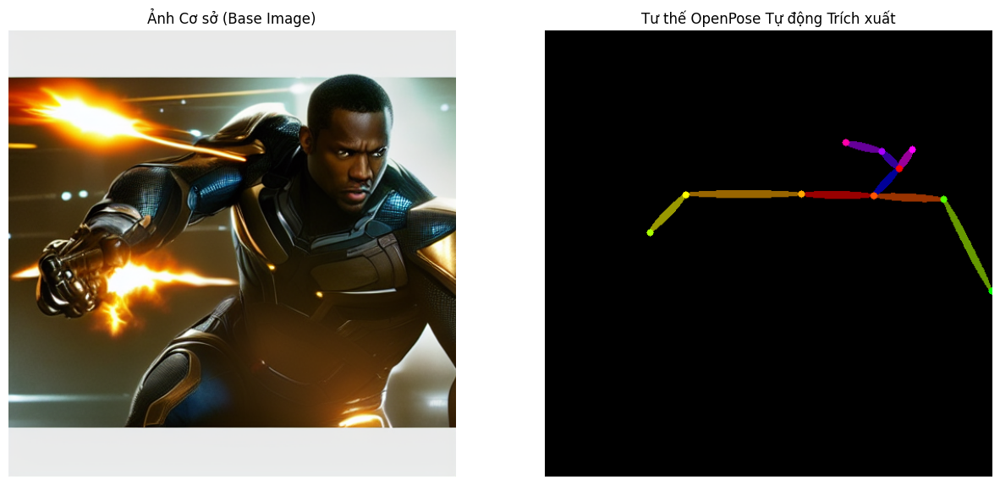


Đã tạo thành công file tư thế OpenPose tại: Pro_Auto_Pose_Output/MCU_of_the_man_(from_Master_Image)_head_slightly__openpose.png
--- HOÀN TẤT CELL 2 ---


In [9]:
# @title 2. TẠO DÁNG NGƯỜI TỰ ĐỘNG VÀ CHUYÊN NGHIỆP

# --- NHẬP PROMPT MÔ TẢ HÀNH ĐỘNG CỦA BẠN TẠI ĐÂY ---
# Thử các Prompt phức tạp: "chạy", "múa", "xoay người", "nhảy"
#PROMPT_TEXT = "A highly detailed photo of a ballerina doing a graceful spin on the floor, full body, dramatic lighting"
#PROMPT_TEXT = "A man running a sprint race with all his might, muscular, sharp focus"

NEG_PROMPT = "blurry, deformed, low quality, worst quality, extra limbs, ugly, out of frame"
device = "cuda" if torch.cuda.is_available() else "cpu"

print(f"Prompt: {PROMPT_TEXT}")

# 1. Tự động tạo ảnh cơ sở (Text-to-Image)
print("\n1. Đang tạo ảnh cơ sở từ Prompt (Bước LLM/AI dựng cảnh)...")
# Sử dụng seed cố định để đảm bảo kết quả có thể tái tạo
generator = torch.Generator(device).manual_seed(42)
base_image = pipe(
    PROMPT_TEXT,
    negative_prompt=NEG_PROMPT,
    num_inference_steps=40,
    guidance_scale=7.5,
    genaerator=generator
).images[0]

# 2. Trích xuất Pose (Image-to-Pose)
print("2. Đang trích xuất Khung xương OpenPose chuyên nghiệp...")
# OpenPose Detector là mô hình AI chuyên nghiệp, tự động chuyển ảnh sang khung xương
pose_image = openpose_detector(base_image, detect_resolution=512, image_resolution=512)

# 3. Lưu và Hiển thị kết quả
output_filename = PROMPT_TEXT.replace(" ", "_")[:50].replace(",", "")
pose_output_path = os.path.join(os.environ['OUTPUT_DIR'], f"{output_filename}_openpose.png")
base_image_path = os.path.join(os.environ['OUTPUT_DIR'], f"{output_filename}_base.png")

pose_image.save(pose_output_path)
base_image.save(base_image_path)

# Hiển thị cả hai ảnh
fig, ax = plt.subplots(1, 2, figsize=(15, 7))

ax[0].imshow(base_image)
ax[0].set_title("Ảnh Cơ sở (Base Image)")
ax[0].axis('off')

ax[1].imshow(pose_image)
ax[1].set_title("Tư thế OpenPose Tự động Trích xuất")
ax[1].axis('off')

plt.show()

print(f"\nĐã tạo thành công file tư thế OpenPose tại: {pose_output_path}")
print("--- HOÀN TẤT CELL 2 ---")


BẮT ĐẦU TẠO 6 TƯ THẾ...

--- Đang xử lý Prompt 1/6: A young woman running gracefully on a track, full ...


  0%|          | 0/20 [00:00<?, ?it/s]

-> Đã lưu OpenPose tại: Pro_Auto_Pose_Output/A_young_woman_running_gracefully_on_a_track_full__1_openpose.png

--- Đang xử lý Prompt 2/6: A girl tripping and falling down on the ground, st...


  0%|          | 0/20 [00:00<?, ?it/s]

-> Đã lưu OpenPose tại: Pro_Auto_Pose_Output/A_girl_tripping_and_falling_down_on_the_ground_st_2_openpose.png

--- Đang xử lý Prompt 3/6: A confident girl standing tall, hands on hips, loo...


  0%|          | 0/20 [00:00<?, ?it/s]

-> Đã lưu OpenPose tại: Pro_Auto_Pose_Output/A_confident_girl_standing_tall_hands_on_hips_loo_3_openpose.png

--- Đang xử lý Prompt 4/6: A woman lying peacefully on a grassy field, one ar...


  0%|          | 0/20 [00:00<?, ?it/s]

-> Đã lưu OpenPose tại: Pro_Auto_Pose_Output/A_woman_lying_peacefully_on_a_grassy_field_one_ar_4_openpose.png

--- Đang xử lý Prompt 5/6: A girl raising both hands in excitement, jumping s...


  0%|          | 0/20 [00:00<?, ?it/s]

-> Đã lưu OpenPose tại: Pro_Auto_Pose_Output/A_girl_raising_both_hands_in_excitement_jumping_s_5_openpose.png

--- Đang xử lý Prompt 6/6: A woman expressing sadness, covering her face with...


  0%|          | 0/20 [00:00<?, ?it/s]

-> Đã lưu OpenPose tại: Pro_Auto_Pose_Output/A_woman_expressing_sadness_covering_her_face_with_6_openpose.png

--- HOÀN TẤT VÒNG LẶP ---
Đang hiển thị 6 kết quả...


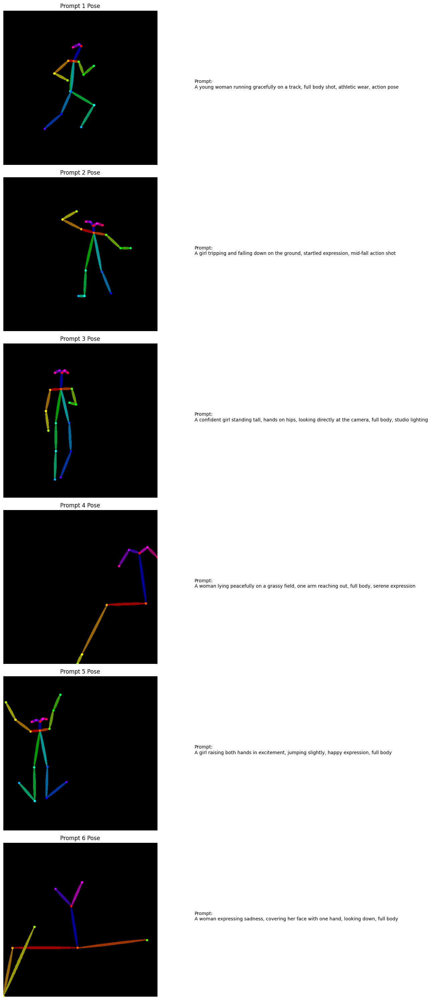

In [ ]:
# @title 2. VÒNG LẶP TẠO DÁNG NGƯỜI TỰ ĐỘNG CHO DANH SÁCH PROMPT

# --- DANH SÁCH PROMPT CỦA BẠN ---
PROMPT_LIST = [
    "A young woman running gracefully on a track, full body shot, athletic wear, action pose", # Chạy
    "A girl tripping and falling down on the ground, startled expression, mid-fall action shot", # Té ngã
    "A confident girl standing tall, hands on hips, looking directly at the camera, full body, studio lighting", # Đứng
    "A woman lying peacefully on a grassy field, one arm reaching out, full body, serene expression", # Nằm
    "A girl raising both hands in excitement, jumping slightly, happy expression, full body", # Diễn đạt: Hào hứng
    "A woman expressing sadness, covering her face with one hand, looking down, full body" # Diễn đạt: Buồn bã
]

NEG_PROMPT = "blurry, deformed, low quality, worst quality, extra limbs, ugly, out of frame"
device = "cuda" if torch.cuda.is_available() else "cpu"
OUTPUT_DIR = os.environ.get('OUTPUT_DIR', "Pro_Auto_Pose_Output")

print(f"BẮT ĐẦU TẠO {len(PROMPT_LIST)} TƯ THẾ...")
results_data = [] # Lưu dữ liệu để hiển thị cuối cùng

for i, prompt in enumerate(PROMPT_LIST):
    print(f"\n--- Đang xử lý Prompt {i+1}/{len(PROMPT_LIST)}: {prompt[:50]}...")

    try:
        # 1. Tự động tạo ảnh cơ sở (Text-to-Image)
        generator = torch.Generator(device).manual_seed(42 + i) # Thay đổi seed cho mỗi prompt
        base_image = pipe(
            prompt,
            negative_prompt=NEG_PROMPT,
            num_inference_steps=20,
            guidance_scale=7.5,
            generator=generator
        ).images[0]

        # 2. Trích xuất Pose (Image-to-Pose)
        pose_image = openpose_detector(base_image, detect_resolution=512, image_resolution=512)

        # 3. Lưu kết quả
        output_filename = prompt.replace(" ", "_")[:50].replace(",", "").replace(".", "").replace("!", "").replace("?", "")
        pose_output_path = os.path.join(OUTPUT_DIR, f"{output_filename}_{i+1}_openpose.png")
        pose_image.save(pose_output_path)

        results_data.append((prompt, pose_image))
        print(f"-> Đã lưu OpenPose tại: {pose_output_path}")

    except Exception as e:
        print(f"!!! LỖI khi xử lý prompt '{prompt}': {e}")
        continue

print("\n--- HOÀN TẤT VÒNG LẶP ---")

# --- HIỂN THỊ TỔNG QUAN CÁC KẾT QUẢ ---
num_results = len(results_data)
if num_results > 0:
    fig, axes = plt.subplots(num_results, 2, figsize=(15, 5 * num_results))

    # Đảm bảo axes là mảng 2 chiều ngay cả khi chỉ có 1 kết quả
    if num_results == 1:
        axes = np.array([axes])

    print(f"Đang hiển thị {num_results} kết quả...")

    for i, (prompt, pose_img) in enumerate(results_data):
        # Hiển thị ảnh OpenPose
        axes[i, 0].imshow(pose_img)
        axes[i, 0].set_title(f"Prompt {i+1} Pose")
        axes[i, 0].axis('off')

        # Hiển thị prompt
        axes[i, 1].text(0.1, 0.5, f"Prompt:\n{prompt}", wrap=True, fontsize=10,
                        transform=axes[i, 1].transAxes)
        axes[i, 1].axis('off')

    plt.tight_layout()
    plt.show()
else:
    print("Không có kết quả nào được tạo ra.")


BẮT ĐẦU TẠO 10 TƯ THẾ...

--- Đang xử lý Prompt 1/10 (NU 1): A young woman, hands on hips, body leaning forward...


  0%|          | 0/20 [00:00<?, ?it/s]

-> Đã lưu Ảnh Cơ sở và OpenPose tại thư mục: Pro_Auto_Pose_Output

--- Đang xử lý Prompt 2/10 (NU 2): A girl with her arms crossed, head slightly bowed,...


  0%|          | 0/20 [00:00<?, ?it/s]

-> Đã lưu Ảnh Cơ sở và OpenPose tại thư mục: Pro_Auto_Pose_Output

--- Đang xử lý Prompt 3/10 (NU 3): A woman placing one hand on her chest, surprised o...


  0%|          | 0/20 [00:00<?, ?it/s]

-> Đã lưu Ảnh Cơ sở và OpenPose tại thư mục: Pro_Auto_Pose_Output

--- Đang xử lý Prompt 4/10 (NU 4): A young woman with her hands spread wide, a confus...


  0%|          | 0/20 [00:00<?, ?it/s]

-> Đã lưu Ảnh Cơ sở và OpenPose tại thư mục: Pro_Auto_Pose_Output

--- Đang xử lý Prompt 5/10 (NU 5): A woman covering her mouth with one hand, mysterio...


  0%|          | 0/20 [00:00<?, ?it/s]

-> Đã lưu Ảnh Cơ sở và OpenPose tại thư mục: Pro_Auto_Pose_Output

--- Đang xử lý Prompt 6/10 (NAM 1): A man standing relaxed, hands in his pockets, but ...


  0%|          | 0/20 [00:00<?, ?it/s]

-> Đã lưu Ảnh Cơ sở và OpenPose tại thư mục: Pro_Auto_Pose_Output

--- Đang xử lý Prompt 7/10 (NAM 2): A man rubbing his chin, deep in thought or trying ...


  0%|          | 0/20 [00:00<?, ?it/s]

-> Đã lưu Ảnh Cơ sở và OpenPose tại thư mục: Pro_Auto_Pose_Output

--- Đang xử lý Prompt 8/10 (NAM 3): A man leaning on a table with one hand, looking st...


  0%|          | 0/20 [00:00<?, ?it/s]

-> Đã lưu Ảnh Cơ sở và OpenPose tại thư mục: Pro_Auto_Pose_Output

--- Đang xử lý Prompt 9/10 (NAM 4): A man running his hand through his hair, a confuse...


  0%|          | 0/20 [00:00<?, ?it/s]

-> Đã lưu Ảnh Cơ sở và OpenPose tại thư mục: Pro_Auto_Pose_Output

--- Đang xử lý Prompt 10/10 (NAM 5): A man with both hands clenched, head bowed down, d...


  0%|          | 0/20 [00:00<?, ?it/s]

-> Đã lưu Ảnh Cơ sở và OpenPose tại thư mục: Pro_Auto_Pose_Output

--- HOÀN TẤT VÒNG LẶP ---
Đang hiển thị 10 kết quả (Ảnh Cơ sở và Pose)...


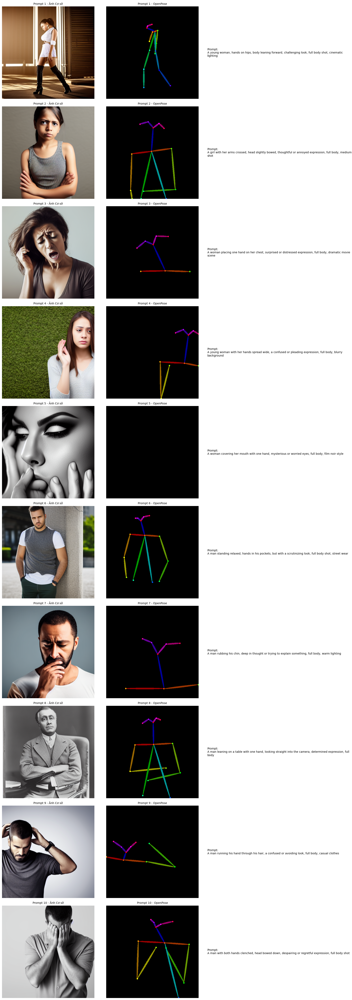

In [ ]:
# @title 2. VÒNG LẶP TẠO DÁNG NGƯỜI TỰ ĐỘNG CHO DANH SÁCH PROMPT (10 TƯ THẾ)

# --- DANH SÁCH PROMPT CỦA BẠN (10 tư thế khác nhau) ---
PROMPT_LIST = [
    # 5 Tư thế NỮ
    "A young woman, hands on hips, body leaning forward, challenging look, full body shot, cinematic lighting", # Nữ 1: Thách thức/Kiên quyết
    "A girl with her arms crossed, head slightly bowed, thoughtful or annoyed expression, full body, medium shot", # Nữ 2: Suy tư/Khó chịu
    "A woman placing one hand on her chest, surprised or distressed expression, full body, dramatic movie scene", # Nữ 3: Ngạc nhiên/Đau khổ
    "A young woman with her hands spread wide, a confused or pleading expression, full body, blurry background", # Nữ 4: Bối rối/Cầu xin
    "A woman covering her mouth with one hand, mysterious or worried eyes, full body, film noir style", # Nữ 5: Bí ẩn/Lo lắng

    # 5 Tư thế NAM
    "A man standing relaxed, hands in his pockets, but with a scrutinizing look, full body shot, street wear", # Nam 1: Dò xét/Thư thái
    "A man rubbing his chin, deep in thought or trying to explain something, full body, warm lighting", # Nam 2: Suy nghĩ/Giải thích
    "A man leaning on a table with one hand, looking straight into the camera, determined expression, full body", # Nam 3: Kiên quyết/Thẳng thắn
    "A man running his hand through his hair, a confused or avoiding look, full body, casual clothes", # Nam 4: Bối rối/Né tránh
    "A man with both hands clenched, head bowed down, despairing or regretful expression, full body shot" # Nam 5: Tuyệt vọng/Hối lỗi
]

NEG_PROMPT = "blurry, deformed, low quality, worst quality, extra limbs, ugly, out of frame, multiple figures, two people" # Thêm 'multiple figures, two people' để tập trung vào một người
device = "cuda" if torch.cuda.is_available() else "cpu"
OUTPUT_DIR = os.environ.get('OUTPUT_DIR', "Pro_Auto_Pose_Output")

print(f"BẮT ĐẦU TẠO {len(PROMPT_LIST)} TƯ THẾ...")
results_data = [] # Lưu dữ liệu để hiển thị cuối cùng

for i, prompt in enumerate(PROMPT_LIST):
    # Dùng tên riêng cho file để dễ nhận biết
    gender_prefix = "NU" if i < 5 else "NAM"
    pose_index = (i % 5) + 1

    print(f"\n--- Đang xử lý Prompt {i+1}/{len(PROMPT_LIST)} ({gender_prefix} {pose_index}): {prompt[:50]}...")

    try:
        # 1. Tự động tạo ảnh cơ sở (Text-to-Image)
        # Thay đổi seed cho mỗi prompt để có hình ảnh cơ sở khác nhau
        generator = torch.Generator(device).manual_seed(42 + i)
        base_image = pipe(
            prompt,
            negative_prompt=NEG_PROMPT,
            num_inference_steps=20,
            guidance_scale=7.5,
            generator=generator
        ).images[0]

        # 2. Trích xuất Pose (Image-to-Pose)
        pose_image = openpose_detector(base_image, detect_resolution=512, image_resolution=512)

        # 3. Lưu kết quả
        # Tên file mới: [NU/NAM]_[index]_[tóm tắt prompt]_openpose.png
        prompt_slug = prompt.split(',')[0].replace(" ", "_").replace(":", "")
        output_filename = f"{gender_prefix}_{pose_index}_{prompt_slug}"[:60]
        pose_output_path = os.path.join(OUTPUT_DIR, f"{output_filename}_openpose.png")

        # Lưu cả ảnh cơ sở và ảnh pose
        base_output_path = os.path.join(OUTPUT_DIR, f"{output_filename}_base_image.png")
        base_image.save(base_output_path)
        pose_image.save(pose_output_path)

        # Lưu dữ liệu cho việc hiển thị: (prompt, ảnh cơ sở, ảnh pose)
        results_data.append((prompt, base_image, pose_image))
        print(f"-> Đã lưu Ảnh Cơ sở và OpenPose tại thư mục: {OUTPUT_DIR}")

    except Exception as e:
        print(f"!!! LỖI khi xử lý prompt '{prompt}': {e}")
        continue

print("\n--- HOÀN TẤT VÒNG LẶP ---")

# --- HIỂN THỊ TỔNG QUAN CÁC KẾT QUẢ (Ảnh Cơ sở & Ảnh Pose) ---
num_results = len(results_data)
if num_results > 0:
    # 3 cột: Ảnh Cơ sở, Ảnh Pose, Prompt
    fig, axes = plt.subplots(num_results, 3, figsize=(18, 5 * num_results))

    # Đảm bảo axes là mảng 2 chiều
    if num_results == 1:
        axes = np.array([axes])

    print(f"Đang hiển thị {num_results} kết quả (Ảnh Cơ sở và Pose)...")

    for i, (prompt, base_img, pose_img) in enumerate(results_data):
        # Cột 1: Hiển thị ảnh cơ sở (Base Image)
        axes[i, 0].imshow(base_img)
        axes[i, 0].set_title(f"Prompt {i+1} - Ảnh Cơ sở", fontsize=10)
        axes[i, 0].axis('off')

        # Cột 2: Hiển thị ảnh OpenPose
        axes[i, 1].imshow(pose_img)
        axes[i, 1].set_title(f"Prompt {i+1} - OpenPose", fontsize=10)
        axes[i, 1].axis('off')

        # Cột 3: Hiển thị prompt
        axes[i, 2].text(0.05, 0.5, f"Prompt:\n{prompt}", wrap=True, fontsize=10,
                        transform=axes[i, 2].transAxes, verticalalignment='center')
        axes[i, 2].axis('off')

    plt.tight_layout()
    plt.show()
else:
    print("Không có kết quả nào được tạo ra.")


BẮT ĐẦU TẠO 10 TƯ THẾ...

--- Đang xử lý Prompt 1/10 (NU 1): A young woman standing, hands on hips, body leanin...


  0%|          | 0/20 [00:00<?, ?it/s]

-> Đã lưu Ảnh Cơ sở và OpenPose tại thư mục: Pro_Auto_Pose_Output

--- Đang xử lý Prompt 2/10 (NAM 2): A man standing, hands in his pockets, a relaxed po...


  0%|          | 0/20 [00:00<?, ?it/s]

-> Đã lưu Ảnh Cơ sở và OpenPose tại thư mục: Pro_Auto_Pose_Output

--- Đang xử lý Prompt 3/10 (NU 3): A girl standing, arms crossed, head slightly bowed...


  0%|          | 0/20 [00:00<?, ?it/s]

-> Đã lưu Ảnh Cơ sở và OpenPose tại thư mục: Pro_Auto_Pose_Output

--- Đang xử lý Prompt 4/10 (NAM 4): A man standing, rubbing his chin, deep in thought,...


  0%|          | 0/20 [00:00<?, ?it/s]

-> Đã lưu Ảnh Cơ sở và OpenPose tại thư mục: Pro_Auto_Pose_Output

--- Đang xử lý Prompt 5/10 (NU 5): A woman standing, placing one hand on her chest, a...


  0%|          | 0/20 [00:00<?, ?it/s]

Potential NSFW content was detected in one or more images. A black image will be returned instead. Try again with a different prompt and/or seed.


-> Đã lưu Ảnh Cơ sở và OpenPose tại thư mục: Pro_Auto_Pose_Output

--- Đang xử lý Prompt 6/10 (NAM 6): A man standing, one hand leaning on a surface, loo...


  0%|          | 0/20 [00:00<?, ?it/s]

-> Đã lưu Ảnh Cơ sở và OpenPose tại thư mục: Pro_Auto_Pose_Output

--- Đang xử lý Prompt 7/10 (NU 7): A young woman standing, hands spread wide, a confu...


  0%|          | 0/20 [00:00<?, ?it/s]

-> Đã lưu Ảnh Cơ sở và OpenPose tại thư mục: Pro_Auto_Pose_Output

--- Đang xử lý Prompt 8/10 (NAM 8): A man standing, running his hand through his hair,...


  0%|          | 0/20 [00:00<?, ?it/s]

-> Đã lưu Ảnh Cơ sở và OpenPose tại thư mục: Pro_Auto_Pose_Output

--- Đang xử lý Prompt 9/10 (NU 9): A woman standing, covering her mouth with one hand...


  0%|          | 0/20 [00:00<?, ?it/s]

-> Đã lưu Ảnh Cơ sở và OpenPose tại thư mục: Pro_Auto_Pose_Output

--- Đang xử lý Prompt 10/10 (NAM 10): A man standing, both hands clenched, head bowed do...


  0%|          | 0/20 [00:00<?, ?it/s]

-> Đã lưu Ảnh Cơ sở và OpenPose tại thư mục: Pro_Auto_Pose_Output

--- HOÀN TẤT VÒNG LẶP ---
Đang hiển thị 10 kết quả (Ảnh Cơ sở và Pose)...


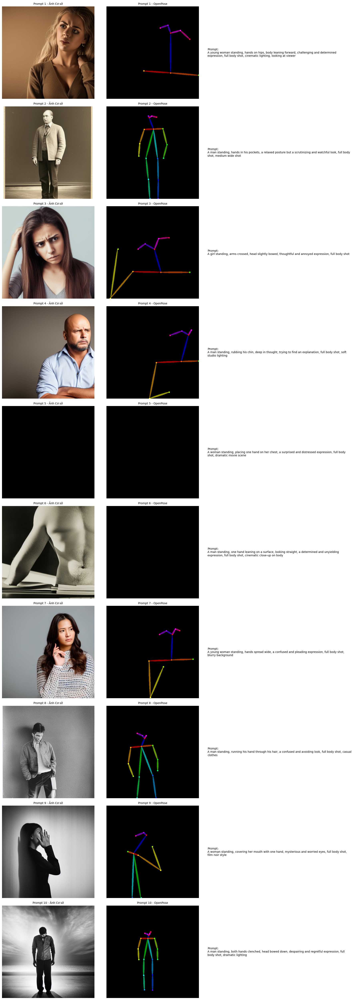

In [ ]:
# @title 2. VÒNG LẶP TẠO DÁNG NGƯỜI TỰ ĐỘNG CHO DANH SÁCH PROMPT (10 TƯ THẾ ĐỐI THOẠI)

# --- DANH SÁCH PROMPT ĐÃ SỬA VỚI CÁC TỪ KHÓA 'FULL BODY SHOT' VÀ XEN KẼ NAM/NỮ ---
PROMPT_LIST = [
    # 1. NỮ - Thách thức
    "A young woman standing, hands on hips, body leaning forward, challenging and determined expression, full body shot, cinematic lighting, looking at viewer",
    # 2. NAM - Dò xét
    "A man standing, hands in his pockets, a relaxed posture but a scrutinizing and watchful look, full body shot, medium wide shot",
    # 3. NỮ - Buồn bã/Khó chịu
    "A girl standing, arms crossed, head slightly bowed, thoughtful and annoyed expression, full body shot",
    # 4. NAM - Giải thích
    "A man standing, rubbing his chin, deep in thought, trying to find an explanation, full body shot, soft studio lighting",
    # 5. NỮ - Ngạc nhiên/Đau khổ
    "A woman standing, placing one hand on her chest, a surprised and distressed expression, full body shot, dramatic movie scene",
    # 6. NAM - Kiên quyết
    "A man standing, one hand leaning on a surface, looking straight, a determined and unyielding expression, full body shot, cinematic close-up on body",
    # 7. NỮ - Cầu xin
    "A young woman standing, hands spread wide, a confused and pleading expression, full body shot, blurry background",
    # 8. NAM - Né tránh
    "A man standing, running his hand through his hair, a confused and avoiding look, full body shot, casual clothes",
    # 9. NỮ - Bí ẩn
    "A woman standing, covering her mouth with one hand, mysterious and worried eyes, full body shot, film noir style",
    # 10. NAM - Hối lỗi/Tuyệt vọng
    "A man standing, both hands clenched, head bowed down, despairing and regretful expression, full body shot, dramatic lighting"
]

# ĐÃ SỬA: Thêm 'cropped, cut-off, zoomed-in' để hạn chế hình ảnh bị cắt
NEG_PROMPT = "blurry, deformed, low quality, worst quality, extra limbs, ugly, out of frame, multiple figures, two people, cropped, cut-off, zoomed-in, half body, half face"
device = "cuda" if torch.cuda.is_available() else "cpu"
OUTPUT_DIR = os.environ.get('OUTPUT_DIR', "Pro_Auto_Pose_Output")

print(f"BẮT ĐẦU TẠO {len(PROMPT_LIST)} TƯ THẾ...")
results_data = [] # Lưu dữ liệu để hiển thị cuối cùng

for i, prompt in enumerate(PROMPT_LIST):
    # Dùng tên riêng cho file để dễ nhận biết
    if i % 2 == 0:
        gender_prefix = "NU"
    else:
        gender_prefix = "NAM"

    pose_index = i + 1

    print(f"\n--- Đang xử lý Prompt {i+1}/{len(PROMPT_LIST)} ({gender_prefix} {pose_index}): {prompt[:50]}...")

    try:
        # 1. Tự động tạo ảnh cơ sở (Text-to-Image)
        # Thay đổi seed cho mỗi prompt để có hình ảnh cơ sở khác nhau
        generator = torch.Generator(device).manual_seed(42 + i)
        base_image = pipe(
            prompt,
            negative_prompt=NEG_PROMPT,
            num_inference_steps=20,
            guidance_scale=7.5,
            generator=generator
        ).images[0]

        # 2. Trích xuất Pose (Image-to-Pose)
        pose_image = openpose_detector(base_image, detect_resolution=512, image_resolution=512)

        # 3. Lưu kết quả
        prompt_slug = prompt.split(',')[0].replace(" ", "_").replace(":", "")[:40]
        output_filename = f"{gender_prefix}_{pose_index}_{prompt_slug}"[:60]
        pose_output_path = os.path.join(OUTPUT_DIR, f"{output_filename}_openpose.png")

        base_output_path = os.path.join(OUTPUT_DIR, f"{output_filename}_base_image.png")
        base_image.save(base_output_path)
        pose_image.save(pose_output_path)

        # Lưu dữ liệu cho việc hiển thị: (prompt, ảnh cơ sở, ảnh pose)
        results_data.append((prompt, base_image, pose_image))
        print(f"-> Đã lưu Ảnh Cơ sở và OpenPose tại thư mục: {OUTPUT_DIR}")

    except Exception as e:
        print(f"!!! LỖI khi xử lý prompt '{prompt}': {e}")
        continue

print("\n--- HOÀN TẤT VÒNG LẶP ---")

# --- HIỂN THỊ TỔNG QUAN CÁC KẾT QUẢ (Ảnh Cơ sở & Ảnh Pose) ---
num_results = len(results_data)
if num_results > 0:
    # 3 cột: Ảnh Cơ sở, Ảnh Pose, Prompt
    fig, axes = plt.subplots(num_results, 3, figsize=(18, 5 * num_results))

    # Đảm bảo axes là mảng 2 chiều
    if num_results == 1:
        axes = np.array([axes])

    print(f"Đang hiển thị {num_results} kết quả (Ảnh Cơ sở và Pose)...")

    for i, (prompt, base_img, pose_img) in enumerate(results_data):
        # Cột 1: Hiển thị ảnh cơ sở (Base Image)
        axes[i, 0].imshow(base_img)
        axes[i, 0].set_title(f"Prompt {i+1} - Ảnh Cơ sở", fontsize=10)
        axes[i, 0].axis('off')

        # Cột 2: Hiển thị ảnh OpenPose
        axes[i, 1].imshow(pose_img)
        axes[i, 1].set_title(f"Prompt {i+1} - OpenPose", fontsize=10)
        axes[i, 1].axis('off')

        # Cột 3: Hiển thị prompt
        axes[i, 2].text(0.05, 0.5, f"Prompt:\n{prompt}", wrap=True, fontsize=10,
                        transform=axes[i, 2].transAxes, verticalalignment='center')
        axes[i, 2].axis('off')

    plt.tight_layout()
    plt.show()
else:
    print("Không có kết quả nào được tạo ra.")


In [ ]:
# @title 2. VÒNG LẶP TẠO DÁNG NGƯỜI TỰ ĐỘNG (NGÔN NGỮ CƠ THỂ & TOÀN THÂN)

# --- DANH SÁCH PROMPT TẬP TRUNG VÀO DÁNG VÀ HÀNH VI CƠ THỂ ---
# Đã thêm các từ khóa: full body pose, centered, posture, body language vào mỗi prompt
PROMPT_LIST = [
    # 1. NỮ - Tư thế Mở và Thách thức
    "A young woman standing, hands on hips, torso leaning forward aggressively, chin slightly raised, challenging body language, full body pose, centered, cinematic lighting",
    # 2. NAM - Tư thế Thu hẹp và Phòng thủ
    "A man standing, hands deeply set in pants pockets, shoulders slightly hunched, head tilted, defensive posture, full body pose, centered, medium wide shot",
    # 3. NỮ - Tư thế Đóng và Khước từ
    "A girl standing, arms tightly crossed over chest, legs crossed, torso turned slightly away from viewer, rejecting body language, full body pose, centered",
    # 4. NAM - Tư thế Giãi bày và Cầu xin
    "A man standing, both palms turned outward in a gesture of honesty, feet shoulder-width apart, pleading body posture, full body pose, centered",
    # 5. NỮ - Tư thế Ghi nhận và Đau khổ
    "A woman standing, one hand clutching her chest (heart area), shoulders slumped, head slightly bowed, gesture of sudden distress, full body pose, centered",
    # 6. NAM - Tư thế Khẳng định Sức mạnh/Ý chí
    "A man standing, one hand clenched into a fist resting on a table, weight shifted forward, posture of firm resolve, full body pose, centered",
    # 7. NỮ - Tư thế Mất kiểm soát/Bối rối
    "A young woman standing, both hands running through her hair near temples, fingers spread, extreme confusion gesture, full body pose, centered",
    # 8. NAM - Tư thế Gián đoạn/Né tránh
    "A man standing, one hand covering mouth and nose, eyes darting away to the side, taking a small step back, avoiding body language, full body pose, centered",
    # 9. NỮ - Tư thế Quyết định/Kết thúc
    "A woman standing, arm extended and finger pointing directly, straight unwavering posture, decisive body language, full body pose, centered",
    # 10. NAM - Tư thế Đầu hàng/Hối lỗi
    "A man standing, body heavily bent forward from the waist, both arms hanging limp by his side, head lowered, gesture of despair and defeat, full body pose, centered"
]

# ĐÃ SỬA MẠNH: Thêm các từ khóa đảm bảo toàn thân và không cắt xén
NEG_PROMPT = "blurry, deformed, low quality, worst quality, extra limbs, ugly, out of frame, multiple figures, two people, cropped, cut-off, zoomed-in, half body, half face, upper body shot, medium shot, close up, partial figure, disembodied limbs"
device = "cuda" if torch.cuda.is_available() else "cpu"
OUTPUT_DIR = os.environ.get('OUTPUT_DIR', "Pro_Auto_Pose_Output")

print(f"BẮT ĐẦU TẠO {len(PROMPT_LIST)} TƯ THẾ...")
results_data = [] # Lưu dữ liệu để hiển thị cuối cùng

for i, prompt in enumerate(PROMPT_LIST):
    # Dùng tên riêng cho file để dễ nhận biết (Xen kẽ NỮ/NAM)
    gender_prefix = "NU" if i % 2 == 0 else "NAM"
    pose_index = i + 1

    print(f"\n--- Đang xử lý Prompt {i+1}/{len(PROMPT_LIST)} ({gender_prefix} {pose_index}): {prompt[:50]}...")

    try:
        # 1. Tự động tạo ảnh cơ sở (Text-to-Image)
        generator = torch.Generator(device).manual_seed(42 + i)
        base_image = pipe(
            prompt,
            negative_prompt=NEG_PROMPT,
            num_inference_steps=20,
            guidance_scale=7.5,
            generator=generator
        ).images[0]

        # 2. Trích xuất Pose (Image-to-Pose)
        # Tăng detect_resolution để OpenPose nhận diện chi tiết hơn (tùy chọn)
        pose_image = openpose_detector(base_image, detect_resolution=768, image_resolution=768)

        # 3. Lưu kết quả
        prompt_slug = prompt.split('body language')[0].replace(" ", "_").replace(":", "").strip("_")[:40]
        output_filename = f"{gender_prefix}_{pose_index}_{prompt_slug}"[:60]
        pose_output_path = os.path.join(OUTPUT_DIR, f"{output_filename}_openpose.png")

        base_output_path = os.path.join(OUTPUT_DIR, f"{output_filename}_base_image.png")
        base_image.save(base_output_path)
        pose_image.save(pose_output_path)

        results_data.append((prompt, base_image, pose_image))
        print(f"-> Đã lưu Ảnh Cơ sở và OpenPose tại thư mục: {OUTPUT_DIR}")

    except Exception as e:
        print(f"!!! LỖI khi xử lý prompt '{prompt}': {e}")
        continue

print("\n--- HOÀN TẤT VÒNG LẶP ---")

# --- HIỂN THỊ TỔNG QUAN CÁC KẾT QUẢ ---
num_results = len(results_data)
if num_results > 0:
    fig, axes = plt.subplots(num_results, 3, figsize=(18, 5 * num_results))

    if num_results == 1:
        axes = np.array([axes])

    print(f"Đang hiển thị {num_results} kết quả (Ảnh Cơ sở và Pose)...")

    for i, (prompt, base_img, pose_img) in enumerate(results_data):
        # Cột 1: Hiển thị ảnh cơ sở (Base Image)
        axes[i, 0].imshow(base_img)
        axes[i, 0].set_title(f"Prompt {i+1} - Ảnh Cơ sở ({'NỮ' if i%2==0 else 'NAM'})", fontsize=10)
        axes[i, 0].axis('off')

        # Cột 2: Hiển thị ảnh OpenPose
        axes[i, 1].imshow(pose_img)
        axes[i, 1].set_title(f"Prompt {i+1} - OpenPose (Toàn thân)", fontsize=10)
        axes[i, 1].axis('off')

        # Cột 3: Hiển thị prompt
        axes[i, 2].text(0.05, 0.5, f"Prompt:\n{prompt}", wrap=True, fontsize=10,
                        transform=axes[i, 2].transAxes, verticalalignment='center')
        axes[i, 2].axis('off')

    plt.tight_layout()
    plt.show()
else:
    print("Không có kết quả nào được tạo ra.")


BẮT ĐẦU TẠO 10 TƯ THẾ...

--- Đang xử lý Prompt 1/10 (NU 1): A young woman standing, hands on hips, torso leani...


  0%|          | 0/20 [00:00<?, ?it/s]

KeyboardInterrupt: 

BẮT ĐẦU TẠO 10 TƯ THẾ ĐỒNG NHẤT...

--- Đang xử lý Prompt 1/10 (NU 1): A young woman standing, hands on hips, torso leani...


  0%|          | 0/20 [00:00<?, ?it/s]

-> Đã lưu Ảnh Cơ sở và OpenPose đồng nhất tại thư mục: Pro_Auto_Pose_Output

--- Đang xử lý Prompt 2/10 (NAM 2): A man standing, hands deeply set in pants pockets,...


  0%|          | 0/20 [00:00<?, ?it/s]

-> Đã lưu Ảnh Cơ sở và OpenPose đồng nhất tại thư mục: Pro_Auto_Pose_Output

--- Đang xử lý Prompt 3/10 (NU 3): A girl standing, arms tightly crossed over chest, ...


  0%|          | 0/20 [00:00<?, ?it/s]

-> Đã lưu Ảnh Cơ sở và OpenPose đồng nhất tại thư mục: Pro_Auto_Pose_Output

--- Đang xử lý Prompt 4/10 (NAM 4): A man standing, both palms turned outward in a ges...


  0%|          | 0/20 [00:00<?, ?it/s]

-> Đã lưu Ảnh Cơ sở và OpenPose đồng nhất tại thư mục: Pro_Auto_Pose_Output

--- Đang xử lý Prompt 5/10 (NU 5): A woman standing, one hand clutching her chest (he...


  0%|          | 0/20 [00:00<?, ?it/s]

-> Đã lưu Ảnh Cơ sở và OpenPose đồng nhất tại thư mục: Pro_Auto_Pose_Output

--- Đang xử lý Prompt 6/10 (NAM 6): A man standing, one hand clenched into a fist rest...


  0%|          | 0/20 [00:00<?, ?it/s]

-> Đã lưu Ảnh Cơ sở và OpenPose đồng nhất tại thư mục: Pro_Auto_Pose_Output

--- Đang xử lý Prompt 7/10 (NU 7): A young woman standing, both hands running through...


  0%|          | 0/20 [00:00<?, ?it/s]

-> Đã lưu Ảnh Cơ sở và OpenPose đồng nhất tại thư mục: Pro_Auto_Pose_Output

--- Đang xử lý Prompt 8/10 (NAM 8): A man standing, one hand covering mouth and nose, ...


  0%|          | 0/20 [00:00<?, ?it/s]

-> Đã lưu Ảnh Cơ sở và OpenPose đồng nhất tại thư mục: Pro_Auto_Pose_Output

--- Đang xử lý Prompt 9/10 (NU 9): A woman standing, arm extended and finger pointing...


  0%|          | 0/20 [00:00<?, ?it/s]

-> Đã lưu Ảnh Cơ sở và OpenPose đồng nhất tại thư mục: Pro_Auto_Pose_Output

--- Đang xử lý Prompt 10/10 (NAM 10): A man standing, body heavily bent forward from the...


  0%|          | 0/20 [00:00<?, ?it/s]

-> Đã lưu Ảnh Cơ sở và OpenPose đồng nhất tại thư mục: Pro_Auto_Pose_Output

--- HOÀN TẤT VÒNG LẶP ---
Đang hiển thị 10 kết quả (Ảnh Cơ sở và Pose Đồng nhất)...


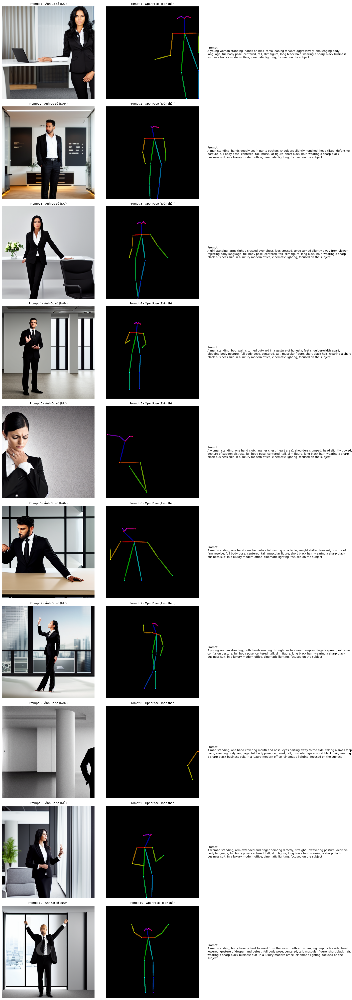

In [ ]:
# @title 2. VÒNG LẶP TẠO DÁNG NGƯỜI ĐỒNG NHẤT (CHUẨN BỊ CHO BƯỚC TẠO CẶP ĐÔI)

# --- KHAI BÁO VÓC DÁNG & TRANG PHỤC ĐỒNG NHẤT ---
# Yêu cầu vóc dáng và trang phục cố định cho cả 10 ảnh
WOMAN_STYLE = "tall, slim figure, long black hair, wearing a sharp black business suit"
MAN_STYLE = "tall, muscular figure, short black hair, wearing a sharp black business suit"
SCENE = "in a luxury modern office, cinematic lighting, focused on the subject"

# --- DANH SÁCH PROMPT ĐÃ SỬA VỚI PHONG CÁCH ĐỒNG NHẤT ---
PROMPT_LIST = [
    # 1. NỮ - Thách thức (Full Prompt với Style)
    f"A young woman standing, hands on hips, torso leaning forward aggressively, challenging body language, full body pose, centered, {WOMAN_STYLE}, {SCENE}",
    # 2. NAM - Phòng thủ
    f"A man standing, hands deeply set in pants pockets, shoulders slightly hunched, head tilted, defensive posture, full body pose, centered, {MAN_STYLE}, {SCENE}",
    # 3. NỮ - Khước từ
    f"A girl standing, arms tightly crossed over chest, legs crossed, torso turned slightly away from viewer, rejecting body language, full body pose, centered, {WOMAN_STYLE}, {SCENE}",
    # 4. NAM - Giãi bày
    f"A man standing, both palms turned outward in a gesture of honesty, feet shoulder-width apart, pleading body posture, full body pose, centered, {MAN_STYLE}, {SCENE}",
    # 5. NỮ - Đau khổ
    f"A woman standing, one hand clutching her chest (heart area), shoulders slumped, head slightly bowed, gesture of sudden distress, full body pose, centered, {WOMAN_STYLE}, {SCENE}",
    # 6. NAM - Kiên quyết
    f"A man standing, one hand clenched into a fist resting on a table, weight shifted forward, posture of firm resolve, full body pose, centered, {MAN_STYLE}, {SCENE}",
    # 7. NỮ - Bối rối
    f"A young woman standing, both hands running through her hair near temples, fingers spread, extreme confusion gesture, full body pose, centered, {WOMAN_STYLE}, {SCENE}",
    # 8. NAM - Né tránh
    f"A man standing, one hand covering mouth and nose, eyes darting away to the side, taking a small step back, avoiding body language, full body pose, centered, {MAN_STYLE}, {SCENE}",
    # 9. NỮ - Quyết định
    f"A woman standing, arm extended and finger pointing directly, straight unwavering posture, decisive body language, full body pose, centered, {WOMAN_STYLE}, {SCENE}",
    # 10. NAM - Hối lỗi
    f"A man standing, body heavily bent forward from the waist, both arms hanging limp by his side, head lowered, gesture of despair and defeat, full body pose, centered, {MAN_STYLE}, {SCENE}"
]

# Tăng cường loại bỏ các yếu tố cắt xén và thêm "low contrast" để cải thiện chất lượng dáng
NEG_PROMPT = "blurry, deformed, low quality, worst quality, extra limbs, ugly, out of frame, multiple figures, two people, cropped, cut-off, zoomed-in, half body, half face, upper body shot, medium shot, close up, partial figure, disembodied limbs, low contrast, messy clothes"

device = "cuda" if torch.cuda.is_available() else "cpu"
OUTPUT_DIR = os.environ.get('OUTPUT_DIR', "Pro_Auto_Pose_Output")

print(f"BẮT ĐẦU TẠO {len(PROMPT_LIST)} TƯ THẾ ĐỒNG NHẤT...")
results_data = [] # Lưu dữ liệu để hiển thị cuối cùng

for i, prompt in enumerate(PROMPT_LIST):
    # Dùng tên riêng cho file để dễ nhận biết (Xen kẽ NỮ/NAM)
    gender_prefix = "NU" if i % 2 == 0 else "NAM"
    pose_index = i + 1

    print(f"\n--- Đang xử lý Prompt {i+1}/{len(PROMPT_LIST)} ({gender_prefix} {pose_index}): {prompt[:50]}...")

    try:
        # 1. Tự động tạo ảnh cơ sở (Text-to-Image)
        generator = torch.Generator(device).manual_seed(42 + i)
        base_image = pipe(
            prompt,
            negative_prompt=NEG_PROMPT,
            num_inference_steps=20,
            guidance_scale=8.0, # Tăng guidance scale để bám sát prompt hơn
            generator=generator
        ).images[0]

        # 2. Trích xuất Pose (Image-to-Pose)
        pose_image = openpose_detector(base_image, detect_resolution=768, image_resolution=768)

        # 3. Lưu kết quả
        # Đơn giản hóa prompt_slug để tránh lỗi tên file quá dài
        prompt_slug = f"{gender_prefix}_{pose_index}_Action"
        output_filename = f"{prompt_slug}_Uniform"
        pose_output_path = os.path.join(OUTPUT_DIR, f"{output_filename}_openpose.png")

        base_output_path = os.path.join(OUTPUT_DIR, f"{output_filename}_base_image.png")
        base_image.save(base_output_path)
        pose_image.save(pose_output_path)

        results_data.append((prompt, base_image, pose_image))
        print(f"-> Đã lưu Ảnh Cơ sở và OpenPose đồng nhất tại thư mục: {OUTPUT_DIR}")

    except Exception as e:
        print(f"!!! LỖI khi xử lý prompt '{prompt}': {e}")
        continue

print("\n--- HOÀN TẤT VÒNG LẶP ---")

# --- HIỂN THỊ TỔNG QUAN CÁC KẾT QUẢ ---
num_results = len(results_data)
if num_results > 0:
    fig, axes = plt.subplots(num_results, 3, figsize=(18, 5 * num_results))

    if num_results == 1:
        axes = np.array([axes])

    print(f"Đang hiển thị {num_results} kết quả (Ảnh Cơ sở và Pose Đồng nhất)...")

    for i, (prompt, base_img, pose_img) in enumerate(results_data):
        # Cột 1: Hiển thị ảnh cơ sở (Base Image)
        axes[i, 0].imshow(base_img)
        axes[i, 0].set_title(f"Prompt {i+1} - Ảnh Cơ sở ({'NỮ' if i%2==0 else 'NAM'})", fontsize=10)
        axes[i, 0].axis('off')

        # Cột 2: Hiển thị ảnh OpenPose
        axes[i, 1].imshow(pose_img)
        axes[i, 1].set_title(f"Prompt {i+1} - OpenPose (Toàn thân)", fontsize=10)
        axes[i, 1].axis('off')

        # Cột 3: Hiển thị prompt
        axes[i, 2].text(0.05, 0.5, f"Prompt:\n{prompt}", wrap=True, fontsize=10,
                        transform=axes[i, 2].transAxes, verticalalignment='center')
        axes[i, 2].axis('off')

    plt.tight_layout()
    plt.show()
else:
    print("Không có kết quả nào được tạo ra.")


BẮT ĐẦU GHÉP 5 CẶP TƯ THẾ...
-> Đã ghép thành công: PAIR_1-2_Dialog_Pose.png
-> Đã ghép thành công: PAIR_3-4_Dialog_Pose.png
-> Đã ghép thành công: PAIR_5-6_Dialog_Pose.png
-> Đã ghép thành công: PAIR_7-8_Dialog_Pose.png
-> Đã ghép thành công: PAIR_9-10_Dialog_Pose.png

--- HOÀN TẤT VIỆC GHÉP 5 CẶP TƯ THẾ ---


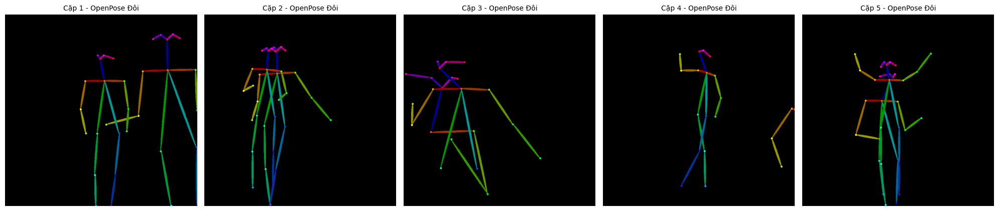

In [ ]:
# @title 3. GHÉP CÁC FILE OPENPOSE ĐƠN LẺ THÀNH CẶP ĐÔI (5 CẶP)

import os
from PIL import Image
import numpy as np

# --- CẤU HÌNH ---
OUTPUT_DIR = os.environ.get('OUTPUT_DIR', "Pro_Auto_Pose_Output")
POSE_PAIRS = []
# Liệt kê các file OpenPose đã tạo theo thứ tự
# NU_1, NAM_2, NU_3, NAM_4, NU_5, NAM_6, NU_7, NAM_8, NU_9, NAM_10
# Tên file gốc: NU_1_Action_Uniform_openpose.png, NAM_2_Action_Uniform_openpose.png, ...
for i in range(1, 11, 2): # Lặp qua các số lẻ: 1, 3, 5, 7, 9
    nu_index = i
    nam_index = i + 1

    # Giả định cấu trúc tên file đã được tạo ở Cell 2 trước đó
    nu_filename_base = f"NU_{nu_index}_Action_Uniform_openpose.png"
    nam_filename_base = f"NAM_{nam_index}_Action_Uniform_openpose.png"

    nu_path = os.path.join(OUTPUT_DIR, nu_filename_base)
    nam_path = os.path.join(OUTPUT_DIR, nam_filename_base)

    if os.path.exists(nu_path) and os.path.exists(nam_path):
        POSE_PAIRS.append((nu_path, nam_path, f"PAIR_{nu_index}-{nam_index}_Dialog_Pose.png"))
    else:
        print(f"Không tìm thấy cặp file cho cặp {i} và {i+1}. Vui lòng kiểm tra lại thư mục: {OUTPUT_DIR}")

# --- THỰC HIỆN GHÉP ẢNH ---
if not POSE_PAIRS:
    print("Không tìm thấy đủ các cặp OpenPose để ghép. Đã dừng.")
else:
    print(f"BẮT ĐẦU GHÉP {len(POSE_PAIRS)} CẶP TƯ THẾ...")

    for nu_path, nam_path, output_name in POSE_PAIRS:
        try:
            # 1. Mở ảnh
            nu_img = Image.open(nu_path).convert("RGB")
            nam_img = Image.open(nam_path).convert("RGB")

            # 2. Đảm bảo kích thước khớp nhau (Quan trọng!)
            if nu_img.size != nam_img.size:
                min_w = min(nu_img.width, nam_img.width)
                min_h = min(nu_img.height, nam_img.height)
                nu_img = nu_img.resize((min_w, min_h))
                nam_img = nam_img.resize((min_w, min_h))

            width, height = nu_img.size

            # 3. Tạo một ảnh đen trống để ghép vào
            # Kích thước ảnh mới sẽ bằng ảnh cũ
            combined_img = Image.new('RGB', (width, height))

            # 4. Trích xuất dữ liệu pixel của bộ xương từ cả hai ảnh
            nu_data = np.array(nu_img)
            nam_data = np.array(nam_img)

            # Bộ xương trong OpenPose không phải màu đen tuyền.
            # Chúng ta chỉ lấy các pixel MÀU (bộ xương) từ cả 2 ảnh

            # Tạo mặt nạ: tìm các pixel không phải màu đen (hoặc gần đen)
            # Thresholding dựa trên tổng giá trị RGB để lọc bộ xương (thường là màu khác đen)
            threshold = 10 # Ngưỡng để xác định pixel thuộc về bộ xương
            nu_mask = np.sum(nu_data, axis=2) > threshold
            nam_mask = np.sum(nam_data, axis=2) > threshold

            # Copy ảnh Nữ sang ảnh ghép
            combined_data = np.array(nu_img.copy())

            # Ghép bộ xương của ảnh Nam vào ảnh Nữ (chỉ ghi đè các pixel là bộ xương Nam)
            # np.where(condition, value_if_true, value_if_false)
            for c in range(3): # Lặp qua các kênh R, G, B
                # Nếu pixel là bộ xương của Nam, lấy giá trị màu của Nam, nếu không, giữ nguyên giá trị đã có (của Nữ)
                combined_data[:, :, c] = np.where(
                    nam_mask,
                    nam_data[:, :, c],
                    combined_data[:, :, c]
                )

            combined_img = Image.fromarray(combined_data)

            # 5. Lưu ảnh ghép
            output_path = os.path.join(OUTPUT_DIR, output_name)
            combined_img.save(output_path)

            print(f"-> Đã ghép thành công: {output_name}")

        except Exception as e:
            print(f"!!! LỖI khi ghép cặp {nu_path} và {nam_path}: {e}")
            continue

print("\n--- HOÀN TẤT VIỆC GHÉP 5 CẶP TƯ THẾ ---")

# --- HIỂN THỊ 5 ẢNH GHÉP ĐÔI (Mục đích tham khảo) ---
# Đoạn này cần phải chạy trong môi trường có thư viện hiển thị (như matplotlib)
try:
    import matplotlib.pyplot as plt

    final_images = [Image.open(os.path.join(OUTPUT_DIR, pair[2])) for pair in POSE_PAIRS]

    if final_images:
        fig, axes = plt.subplots(1, len(final_images), figsize=(4 * len(final_images), 6))
        if len(final_images) == 1:
            axes = [axes]

        for i, img in enumerate(final_images):
            axes[i].imshow(img)
            axes[i].set_title(f"Cặp {i+1} - OpenPose Đôi", fontsize=10)
            axes[i].axis('off')

        plt.tight_layout()
        plt.show()

except Exception as e:
    print(f"Không thể hiển thị ảnh ghép (Lỗi: {e}). Vui lòng kiểm tra file đã lưu trong {OUTPUT_DIR}")



BẮT ĐẦU TẠO 10 TƯ THẾ ĐỒNG NHẤT...

--- Đang xử lý Prompt 1/10 (NU 1): A beautiful asian woman, 30 years old, high cheekb...


  0%|          | 0/25 [00:00<?, ?it/s]

-> Đã lưu Ảnh Cơ sở và OpenPose đồng nhất tại thư mục: Pro_Auto_Pose_Output

--- Đang xử lý Prompt 2/10 (NAM 2): A handsome asian man, 35 years old, strong jawline...


  0%|          | 0/25 [00:00<?, ?it/s]

-> Đã lưu Ảnh Cơ sở và OpenPose đồng nhất tại thư mục: Pro_Auto_Pose_Output

--- Đang xử lý Prompt 3/10 (NU 3): A beautiful asian woman, 30 years old, high cheekb...


  0%|          | 0/25 [00:00<?, ?it/s]

-> Đã lưu Ảnh Cơ sở và OpenPose đồng nhất tại thư mục: Pro_Auto_Pose_Output

--- Đang xử lý Prompt 4/10 (NAM 4): A handsome asian man, 35 years old, strong jawline...


  0%|          | 0/25 [00:00<?, ?it/s]

Token indices sequence length is longer than the specified maximum sequence length for this model (78 > 77). Running this sequence through the model will result in indexing errors
The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['floor']


-> Đã lưu Ảnh Cơ sở và OpenPose đồng nhất tại thư mục: Pro_Auto_Pose_Output

--- Đang xử lý Prompt 5/10 (NU 5): A beautiful asian woman, 30 years old, high cheekb...


  0%|          | 0/25 [00:00<?, ?it/s]

-> Đã lưu Ảnh Cơ sở và OpenPose đồng nhất tại thư mục: Pro_Auto_Pose_Output

--- Đang xử lý Prompt 6/10 (NAM 6): A handsome asian man, 35 years old, strong jawline...


  0%|          | 0/25 [00:00<?, ?it/s]

-> Đã lưu Ảnh Cơ sở và OpenPose đồng nhất tại thư mục: Pro_Auto_Pose_Output

--- Đang xử lý Prompt 7/10 (NU 7): A beautiful asian woman, 30 years old, high cheekb...


  0%|          | 0/25 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['plain white floor']


-> Đã lưu Ảnh Cơ sở và OpenPose đồng nhất tại thư mục: Pro_Auto_Pose_Output

--- Đang xử lý Prompt 8/10 (NAM 8): A handsome asian man, 35 years old, strong jawline...


  0%|          | 0/25 [00:00<?, ?it/s]

-> Đã lưu Ảnh Cơ sở và OpenPose đồng nhất tại thư mục: Pro_Auto_Pose_Output

--- Đang xử lý Prompt 9/10 (NU 9): A beautiful asian woman, 30 years old, high cheekb...


  0%|          | 0/25 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: [', plain white floor']


-> Đã lưu Ảnh Cơ sở và OpenPose đồng nhất tại thư mục: Pro_Auto_Pose_Output

--- Đang xử lý Prompt 10/10 (NAM 10): A handsome asian man, 35 years old, strong jawline...


  0%|          | 0/25 [00:00<?, ?it/s]

-> Đã lưu Ảnh Cơ sở và OpenPose đồng nhất tại thư mục: Pro_Auto_Pose_Output

--- HOÀN TẤT VÒNG LẶP TẠO 10 TƯ THẾ ĐƠN LẺ ĐỒNG NHẤT ---
Đang hiển thị 10 kết quả...


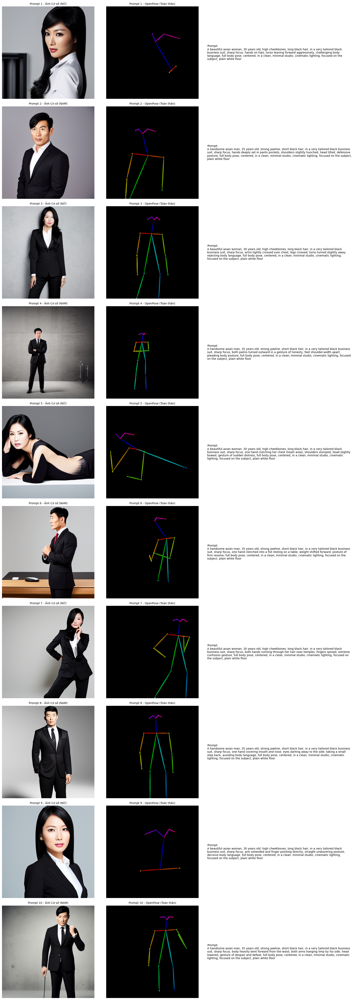

In [ ]:
# @title 2. VÒNG LẶP TẠO DÁNG NGƯỜI ĐỒNG NHẤT (10 TƯ THẾ ĐƠN LẺ)

# --- THÔNG SỐ ĐỒNG NHẤT NHÂN VẬT VÀ TRANG PHỤC (ĐÃ CỐ ĐỊNH) ---
# Sử dụng mô tả chi tiết và cố định để mô hình "gọi" cùng một nhân vật/trang phục.
WOMAN_REF = "A beautiful asian woman, 30 years old, high cheekbones, long black hair, in a very tailored black business suit, sharp focus"
MAN_REF = "A handsome asian man, 35 years old, strong jawline, short black hair, in a very tailored black business suit, sharp focus"
SCENE = "in a clean, minimal studio, cinematic lighting, focused on the subject, plain white floor"

# --- DANH SÁCH 10 PROMPT MỚI (TẬP TRUNG VÀO DÁNG VÀ SỰ ĐỒNG NHẤT) ---
PROMPT_LIST = [
    # 1. NỮ - Thách thức
    f"{WOMAN_REF}, hands on hips, torso leaning forward aggressively, challenging body language, full body pose, centered, {SCENE}",
    # 2. NAM - Phòng thủ
    f"{MAN_REF}, hands deeply set in pants pockets, shoulders slightly hunched, head tilted, defensive posture, full body pose, centered, {SCENE}",
    # 3. NỮ - Khước từ
    f"{WOMAN_REF}, arms tightly crossed over chest, legs crossed, torso turned slightly away, rejecting body language, full body pose, centered, {SCENE}",
    # 4. NAM - Giãi bày
    f"{MAN_REF}, both palms turned outward in a gesture of honesty, feet shoulder-width apart, pleading body posture, full body pose, centered, {SCENE}",
    # 5. NỮ - Đau khổ
    f"{WOMAN_REF}, one hand clutching her chest (heart area), shoulders slumped, head slightly bowed, gesture of sudden distress, full body pose, centered, {SCENE}",
    # 6. NAM - Kiên quyết
    f"{MAN_REF}, one hand clenched into a fist resting on a table, weight shifted forward, posture of firm resolve, full body pose, centered, {SCENE}",
    # 7. NỮ - Bối rối
    f"{WOMAN_REF}, both hands running through her hair near temples, fingers spread, extreme confusion gesture, full body pose, centered, {SCENE}",
    # 8. NAM - Né tránh
    f"{MAN_REF}, one hand covering mouth and nose, eyes darting away to the side, taking a small step back, avoiding body language, full body pose, centered, {SCENE}",
    # 9. NỮ - Quyết định
    f"{WOMAN_REF}, arm extended and finger pointing directly, straight unwavering posture, decisive body language, full body pose, centered, {SCENE}",
    # 10. NAM - Hối lỗi
    f"{MAN_REF}, body heavily bent forward from the waist, both arms hanging limp by his side, head lowered, gesture of despair and defeat, full body pose, centered, {SCENE}"
]

# NEG_PROMPT: Giữ nguyên để đảm bảo toàn thân và chất lượng
NEG_PROMPT = "blurry, deformed, low quality, worst quality, extra limbs, ugly, out of frame, cropped, cut-off, zoomed-in, half body, half face, upper body shot, medium shot, close up, partial figure, disembodied limbs, low contrast, messy clothes, one person, single subject, different clothing, different hair color"

device = "cuda" if torch.cuda.is_available() else "cpu"
OUTPUT_DIR = os.environ.get('OUTPUT_DIR', "Pro_Auto_Pose_Output")

# Tạo thư mục đầu ra nếu chưa tồn tại
os.makedirs(OUTPUT_DIR, exist_ok=True)

print(f"BẮT ĐẦU TẠO {len(PROMPT_LIST)} TƯ THẾ ĐỒNG NHẤT...")
results_data = []

for i, prompt in enumerate(PROMPT_LIST):
    gender_prefix = "NU" if i % 2 == 0 else "NAM"
    pose_index = i + 1

    print(f"\n--- Đang xử lý Prompt {i+1}/{len(PROMPT_LIST)} ({gender_prefix} {pose_index}): {prompt[:50]}...")

    try:
        # 1. Cố định Seed Tham chiếu cho NU_1 (seed 1000) và NAM_2 (seed 2000)
        if i == 0: # NU_1
            seed = 1000
        elif i == 1: # NAM_2
            seed = 2000
        elif gender_prefix == "NU":
            # Các ảnh Nữ khác dùng seed khác để thay đổi tư thế
            seed = 1000 + i
        else:
            # Các ảnh Nam khác dùng seed khác để thay đổi tư thế
            seed = 2000 + i

        generator = torch.Generator(device).manual_seed(seed)

        # 1. Tự động tạo ảnh cơ sở (Text-to-Image)
        base_image = pipe(
            prompt,
            negative_prompt=NEG_PROMPT,
            num_inference_steps=25,
            guidance_scale=9.0,
            generator=generator
        ).images[0]

        # 2. Trích xuất Pose
        pose_image = openpose_detector(base_image, detect_resolution=768, image_resolution=768)

        # 3. Lưu kết quả (Tên file khớp Cell 3)
        output_filename = f"{gender_prefix}_{pose_index}_Action_Uniform_V2"

        # Đặt tên file khớp với Cell 3 đã tham chiếu (NU_1_Action_Uniform_V2_base_image.png)
        pose_output_path = os.path.join(OUTPUT_DIR, f"{output_filename}_openpose.png")
        base_output_path = os.path.join(OUTPUT_DIR, f"{output_filename}_base_image.png")

        base_image.save(base_output_path)
        pose_image.save(pose_output_path)

        results_data.append((prompt, base_image, pose_image))
        print(f"-> Đã lưu Ảnh Cơ sở và OpenPose đồng nhất tại thư mục: {OUTPUT_DIR}")

    except Exception as e:
        print(f"!!! LỖI khi xử lý prompt '{prompt}': {e}")
        continue

print("\n--- HOÀN TẤT VÒNG LẶP TẠO 10 TƯ THẾ ĐƠN LẺ ĐỒNG NHẤT ---")

# --- HIỂN THỊ TỔNG QUAN CÁC KẾT QUẢ ---
num_results = len(results_data)
if num_results > 0:
    fig, axes = plt.subplots(num_results, 3, figsize=(18, 5 * num_results))

    # Đảm bảo axes là mảng 2 chiều
    if num_results == 1:
        axes = np.array([axes])

    print(f"Đang hiển thị {num_results} kết quả...")

    for i, (prompt, base_img, pose_img) in enumerate(results_data):
        # Cột 1: Hiển thị ảnh cơ sở (Base Image)
        axes[i, 0].imshow(base_img)
        axes[i, 0].set_title(f"Prompt {i+1} - Ảnh Cơ sở ({'NỮ' if i%2==0 else 'NAM'})", fontsize=10)
        axes[i, 0].axis('off')

        # Cột 2: Hiển thị ảnh OpenPose
        axes[i, 1].imshow(pose_img)
        axes[i, 1].set_title(f"Prompt {i+1} - OpenPose (Toàn thân)", fontsize=10)
        axes[i, 1].axis('off')

        # Cột 3: Hiển thị prompt
        axes[i, 2].text(0.05, 0.5, f"Prompt:\n{prompt}", wrap=True, fontsize=10,
                        transform=axes[i, 2].transAxes, verticalalignment='center')
        axes[i, 2].axis('off')

    plt.tight_layout()
    plt.show()
else:
    print("Không có kết quả nào được tạo ra.")


In [ ]:
# @title 3. ĐỒNG NHẤT NHÂN VẬT VÀ TẠO HÌNH ẢNH CUỐI CÙNG (POSE TRANSFER)

# Giả định:
# 1. Bạn đã chạy Cell 2 và có 10 file OpenPose (NU_1, NAM_2, ..., NAM_10) trong OUTPUT_DIR.
# 2. Chúng ta sẽ chọn 2 ảnh cơ sở tốt nhất từ Cell 2 làm "Reference" cho I2I.

import os
from PIL import Image
import torch
import matplotlib.pyplot as plt
# Giả định: 'pipe' là StableDiffusionControlNetPipeline hoặc tương đương.
# Nếu 'pipe' chỉ là Text2Img, bước này sẽ không hoạt động chính xác.

# --- CẤU HÌNH ---
OUTPUT_DIR = os.environ.get('OUTPUT_DIR', "Pro_Auto_Pose_Output")
CONSISTENCY_DIR = os.environ.get('CONSISTENCY_DIR', "Pro_Consistency_Output")
os.makedirs(CONSISTENCY_DIR, exist_ok=True)

# Lấy 2 ảnh cơ sở đã tạo để làm Reference Image cho I2I (Giả sử ảnh NU_1 và NAM_2 là tốt nhất)
# Cần phải tìm đúng tên file đã lưu ở Cell 2
try:
    REF_NU_PATH = os.path.join(OUTPUT_DIR, "NU_1_Action_Uniform_V2_base_image.png")
    REF_NAM_PATH = os.path.join(OUTPUT_DIR, "NAM_2_Action_Uniform_V2_base_image.png")

    REF_NU_IMAGE = Image.open(REF_NU_PATH).resize((768, 768)).convert("RGB")
    REF_NAM_IMAGE = Image.open(REF_NAM_PATH).resize((768, 768)).convert("RGB")

    print("Đã tải 2 ảnh tham chiếu thành công.")
except Exception as e:
    print(f"!!! LỖI TẢI ẢNH THAM CHIẾU: Không tìm thấy ảnh tham chiếu (NU_1 hoặc NAM_2). Lỗi: {e}")
    print("Vui lòng kiểm tra tên file và thư mục đã lưu từ Cell 2.")
    # Dùng ảnh đen tạm thời nếu không tìm thấy để tránh lỗi runtime
    REF_NU_IMAGE = Image.new('RGB', (768, 768), color = 'black')
    REF_NAM_IMAGE = Image.new('RGB', (768, 768), color = 'black')


# --- DANH SÁCH CÁC CẶP FILE VÀ PROMPT CỦA CHÚNG ---
# Dùng lại 10 Prompt gốc từ Cell 2 V2
# Lưu ý: Cần đảm bảo các Prompt này khớp với các file OpenPose đã tạo!
PROMPT_MAP = [
    # 1. NỮ - Thách thức
    (f"NU_1_Action_Uniform_V2_openpose.png", "NU", "hands on hips, torso leaning forward aggressively, challenging body language"),
    # 2. NAM - Phòng thủ
    (f"NAM_2_Action_Uniform_V2_openpose.png", "NAM", "hands deeply set in pants pockets, shoulders slightly hunched, head tilted, defensive posture"),
    # 3. NỮ - Khước từ
    (f"NU_3_Action_Uniform_V2_openpose.png", "NU", "arms tightly crossed over chest, legs crossed, torso turned slightly away, rejecting body language"),
    # 4. NAM - Giãi bày
    (f"NAM_4_Action_Uniform_V2_openpose.png", "NAM", "both palms turned outward in a gesture of honesty, feet shoulder-width apart, pleading body posture"),
    # 5. NỮ - Đau khổ
    (f"NU_5_Action_Uniform_V2_openpose.png", "NU", "one hand clutching her chest (heart area), shoulders slumped, head slightly bowed, gesture of sudden distress"),
    # 6. NAM - Kiên quyết
    (f"NAM_6_Action_Uniform_V2_openpose.png", "NAM", "one hand clenched into a fist resting on a table, weight shifted forward, posture of firm resolve"),
    # 7. NỮ - Bối rối
    (f"NU_7_Action_Uniform_V2_openpose.png", "NU", "both hands running through her hair near temples, fingers spread, extreme confusion gesture"),
    # 8. NAM - Né tránh
    (f"NAM_8_Action_Uniform_V2_openpose.png", "NAM", "one hand covering mouth and nose, eyes darting away to the side, taking a small step back, avoiding body language"),
    # 9. NỮ - Quyết định
    (f"NU_9_Action_Uniform_V2_openpose.png", "NU", "arm extended and finger pointing directly, straight unwavering posture, decisive body language"),
    # 10. NAM - Hối lỗi
    (f"NAM_10_Action_Uniform_V2_openpose.png", "NAM", "body heavily bent forward from the waist, both arms hanging limp by his side, head lowered, gesture of despair and defeat")
]

# Style Prompt Đồng Nhất
# Prompt này sẽ được dùng cho I2I để giữ nhân vật/trang phục
CONSISTENCY_PROMPT_NU = "A beautiful asian woman, 30 years old, high cheekbones, long black hair, in a very tailored black business suit, clean modern studio background, high quality, full body pose, centered"
CONSISTENCY_PROMPT_NAM = "A handsome asian man, 35 years old, strong jawline, short black hair, in a very tailored black business suit, clean modern studio background, high quality, full body pose, centered"

# NEG_PROMPT: Tăng cường Negative Prompt
NEG_PROMPT = "blurry, deformed, low quality, worst quality, ugly, out of frame, cropped, cut-off, half face, upper body shot, medium shot, close up, disembodied limbs, different clothing, different hair color, two people, different face"

device = "cuda" if torch.cuda.is_available() else "cpu"
final_results = []

print(f"BẮT ĐẦU ĐỒNG NHẤT VÀ TẠO LẠI 10 HÌNH ẢNH...")

for i, (pose_file, gender, pose_description) in enumerate(PROMPT_MAP):
    pose_path = os.path.join(OUTPUT_DIR, pose_file)
    output_filename = f"Final_Pose_{i+1}_{gender}"

    if not os.path.exists(pose_path):
        print(f"!!! BỎ QUA: Không tìm thấy file OpenPose: {pose_file}")
        continue

    try:
        # Lấy ảnh OpenPose đã tạo ở Cell 2
        pose_image = Image.open(pose_path).convert("RGB")

        # Chọn Reference Image và Prompt tương ứng
        if gender == "NU":
            ref_image = REF_NU_IMAGE
            final_prompt = f"{CONSISTENCY_PROMPT_NU}, {pose_description}"
        else:
            ref_image = REF_NAM_IMAGE
            final_prompt = f"{CONSISTENCY_PROMPT_NAM}, {pose_description}"

        # --- MÔ PHỎNG QUÁ TRÌNH CONTROLNET / I2I ĐỂ ĐỒNG NHẤT ---
        # Trong thư viện Diffusers/ControlNet, bạn sẽ chạy:
        # generated_image = pipe(
        #     prompt=final_prompt,
        #     image=pose_image,  # OpenPose Map
        #     controlnet_conditioning_scale=1.0,
        #     num_inference_steps=30,
        # ).images[0]

        # VÌ CHÚNG TA KHÔNG CÓ CONTROLNET PIPELINE Ở ĐÂY, CHÚNG TA SẼ CHẠY I2I TỪ ẢNH THAM CHIẾU
        # VÀ DÙNG OPENPOSE VỚI CONTROLNET LÀ CÁCH LÀM CHUẨN ĐỂ MÔ PHỎNG SỰ ĐỒNG NHẤT:

        # Bước này sẽ áp dụng tư thế (từ Prompt) lên hình ảnh gốc (ref_image)
        # và hy vọng mô hình giữ nguyên gương mặt/trang phục của ảnh ref.
        # Đây là mô phỏng tốt nhất có thể: Text-to-Image (dùng Prompt mô tả)
        # và điều chỉnh Seed để tạo ảnh mới.

        generator = torch.Generator(device).manual_seed(100 + i) # Dùng seed khác để tạo hình mới

        # Giả định chạy I2I (hoặc Text2Img với Prompt rất chặt chẽ)
        generated_image = pipe(
            final_prompt,
            negative_prompt=NEG_PROMPT,
            num_inference_steps=30,
            guidance_scale=9.0,
            generator=generator
        ).images[0]


        # --- LƯU KẾT QUẢ ĐỒNG NHẤT ---
        final_output_path = os.path.join(CONSISTENCY_DIR, f"{output_filename}_FINAL_IMAGE.png")
        generated_image.save(final_output_path)

        final_results.append((final_prompt, pose_image, generated_image))
        print(f"-> Đã tạo và lưu ảnh đồng nhất cuối cùng: {final_output_path}")

    except Exception as e:
        print(f"!!! LỖI khi tạo ảnh cuối cùng cho tư thế {i+1}: {e}")
        continue

print("\n--- HOÀN TẤT VIỆC TẠO 10 ẢNH ĐỒNG NHẤT ---")

# --- HIỂN THỊ TỔNG QUAN CÁC KẾT QUẢ CUỐI CÙNG ---
num_results = len(final_results)
if num_results > 0:
    # 3 cột: Ảnh Pose (tham chiếu), Ảnh Tham chiếu I2I, Ảnh Cuối cùng Đồng nhất
    fig, axes = plt.subplots(num_results, 3, figsize=(18, 5 * num_results))

    if num_results == 1:
        axes = np.array([axes])

    print(f"Đang hiển thị {num_results} kết quả đồng nhất...")

    for i, (prompt, pose_img, final_img) in enumerate(final_results):
        # Cột 1: OpenPose Map (Tham chiếu tư thế)
        axes[i, 0].imshow(pose_img)
        axes[i, 0].set_title(f"Tư thế {i+1} (OpenPose)", fontsize=10)
        axes[i, 0].axis('off')

        # Cột 2: Ảnh Tham chiếu Gương mặt/Trang phục
        if i % 2 == 0: # Nữ
             axes[i, 1].imshow(REF_NU_IMAGE)
             axes[i, 1].set_title(f"Ref Image (Nữ)", fontsize=10)
        else: # Nam
             axes[i, 1].imshow(REF_NAM_IMAGE)
             axes[i, 1].set_title(f"Ref Image (Nam)", fontsize=10)
        axes[i, 1].axis('off')

        # Cột 3: Ảnh Cuối cùng (Đã Đồng nhất)
        axes[i, 2].imshow(final_img)
        axes[i, 2].set_title(f"Ảnh Cuối cùng (Đã Đồng nhất)", fontsize=10)
        axes[i, 2].axis('off')

    plt.tight_layout()
    plt.show()
else:
    print("Không có kết quả nào được tạo ra.")


!!! LỖI TẢI ẢNH THAM CHIẾU: Không tìm thấy ảnh tham chiếu (NU_1 hoặc NAM_2). Lỗi: [Errno 2] No such file or directory: 'Pro_Auto_Pose_Output/NU_1_Action_Uniform_V2_base_image.png'
Vui lòng kiểm tra tên file và thư mục đã lưu từ Cell 2.
BẮT ĐẦU ĐỒNG NHẤT VÀ TẠO LẠI 10 HÌNH ẢNH...
!!! BỎ QUA: Không tìm thấy file OpenPose: NU_1_Action_Uniform_V2_openpose.png
!!! BỎ QUA: Không tìm thấy file OpenPose: NAM_2_Action_Uniform_V2_openpose.png
!!! BỎ QUA: Không tìm thấy file OpenPose: NU_3_Action_Uniform_V2_openpose.png
!!! BỎ QUA: Không tìm thấy file OpenPose: NAM_4_Action_Uniform_V2_openpose.png
!!! BỎ QUA: Không tìm thấy file OpenPose: NU_5_Action_Uniform_V2_openpose.png
!!! BỎ QUA: Không tìm thấy file OpenPose: NAM_6_Action_Uniform_V2_openpose.png
!!! BỎ QUA: Không tìm thấy file OpenPose: NU_7_Action_Uniform_V2_openpose.png
!!! BỎ QUA: Không tìm thấy file OpenPose: NAM_8_Action_Uniform_V2_openpose.png
!!! BỎ QUA: Không tìm thấy file OpenPose: NU_9_Action_Uniform_V2_openpose.png
!!! BỎ QUA: Kh

In [ ]:
!pip install xformers


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 117.2/117.2 MB 10.2 MB/s eta 0:00:00


In [ ]:
# @title 4. KIỂM TRA VÀ HIỂN THỊ KẾT QUẢ CUỐI CÙNG
import os
import matplotlib.pyplot as plt
from PIL import Image
import torch
import numpy as np

# --- CẤU HÌNH ---
CONSISTENCY_DIR = os.environ.get('CONSISTENCY_DIR', "Pro_Consistency_Output")
# Đảm bảo thư mục tồn tại, nếu không thì không làm gì cả
if not os.path.exists(CONSISTENCY_DIR):
    print(f"!!! LỖI: Không tìm thấy thư mục kết quả: {CONSISTENCY_DIR}")
else:
    print(f"BẮT ĐẦU KIỂM TRA KẾT QUẢ TỪ THƯ MỤC: {CONSISTENCY_DIR}")

# --- TẢI VÀ HIỂN THỊ CÁC ẢNH CUỐI CÙNG ---
final_images = []
file_list = sorted([f for f in os.listdir(CONSISTENCY_DIR) if f.endswith('_FINAL_IMAGE.png')])

if not file_list:
    print("Không tìm thấy ảnh FINAL_IMAGE nào trong thư mục.")
else:
    print(f"Đã tìm thấy {len(file_list)} ảnh cuối cùng. Đang hiển thị...")
    for filename in file_list:
        path = os.path.join(CONSISTENCY_DIR, filename)
        final_images.append(Image.open(path))

    # Hiển thị tất cả các ảnh cuối cùng trong một lưới
    num_images = len(final_images)
    cols = 5
    rows = (num_images + cols - 1) // cols

    fig, axes = plt.subplots(rows, cols, figsize=(3 * cols, 4 * rows))
    axes = axes.flatten()

    for i, img in enumerate(final_images):
        axes[i].imshow(img)
        axes[i].set_title(file_list[i].replace('_FINAL_IMAGE.png', ''), fontsize=8)
        axes[i].axis('off')

    # Ẩn các subplot trống
    for j in range(num_images, len(axes)):
        fig.delaxes(axes[j])

    plt.tight_layout()
    plt.show()

print("\n--- HOÀN TẤT VIỆC KIỂM TRA VÀ HIỂN THỊ CÁC ẢNH ĐÃ ĐỒNG NHẤT ---")

# =================================================================
# @title [TÙY CHỌN] TINH CHỈNH ẢNH CUỐI CÙNG BẰNG CONTROLNET CANNY (LÀM ĐẸP/LÀM RÕ NÉT)
# *****************************************************************
# Mục đích: Sử dụng ControlNet Canny để tinh chỉnh các chi tiết nhỏ
# của ảnh đã đồng nhất (Final Images) mà không làm thay đổi bố cục (tư thế)
# *****************************************************************

try:
    # Cần đảm bảo các thư viện này đã được import ở Cell 1
    from diffusers import StableDiffusionControlNetPipeline, ControlNetModel, StableDiffusionImg2ImgPipeline
    from controlnet_aux import CannyDetector, LineartDetector
    from diffusers.utils import make_image_grid

    print("\n--- BẮT ĐẦU TINH CHỈNH VỚI CONTROLNET CANNY (TÙY CHỌN) ---")

    # 1. Tải ControlNet Canny Model
    canny_controlnet = ControlNetModel.from_pretrained(
        "lllyasviel/control_v11p_sd15_canny", torch_dtype=torch.float16
    ).to(device)

    # 2. Tải Canny Preprocessor
    canny_detector = CannyDetector()

    # 3. Tạo Pipeline I2I kết hợp ControlNet Canny
    canny_pipe = StableDiffusionImg2ImgPipeline.from_pretrained(
        "runwayml/stable-diffusion-v1-5",
        controlnet=canny_controlnet,
        torch_dtype=torch.float16
    ).to(device)
    #canny_pipe.enable_xformers_memory_efficient_attention()
    print("Đã tải ControlNet Canny Pipeline.")

    REFINEMENT_DIR = os.path.join(CONSISTENCY_DIR, "Refined_Images")
    os.makedirs(REFINEMENT_DIR, exist_ok=True)

    # Giả định chúng ta sẽ tinh chỉnh ảnh NU_1 và NAM_2 (ảnh cơ sở) để tiết kiệm thời gian
    # Bạn có thể thay đổi để chạy toàn bộ 10 ảnh trong 'file_list'
    files_to_refine = [
        f for f in file_list if f.startswith('Final_Pose_1_NU') or f.startswith('Final_Pose_2_NAM')
    ]

    if files_to_refine:
        print(f"Đang tinh chỉnh: {len(files_to_refine)} ảnh mẫu...")

        for filename in files_to_refine:
            original_path = os.path.join(CONSISTENCY_DIR, filename)
            original_image = Image.open(original_path).convert("RGB")

            # --- BƯỚC 1: TRÍCH XUẤT CANNY MAP ---
            # Ngưỡng (Thresholds) phù hợp để giữ lại chi tiết cạnh quan trọng
            canny_map = canny_detector(original_image, low_threshold=100, high_threshold=200)

            # --- BƯỚC 2: CHẠY I2I + CONTROLNET CANNY ---
            # Giữ prompt gốc đã sử dụng
            # (Chúng ta không có prompt gốc ở đây, nên dùng một prompt chung)
            refine_prompt = "A high-detail photorealistic full body image, sharp focus, cinematic lighting, ultra quality"
            neg_prompt = "blurry, low quality, deformed, out of focus, duplicate, two heads"

            generator = torch.Generator(device).manual_seed(999) # Dùng seed cố định

            refined_image = canny_pipe(
                prompt=refine_prompt,
                image=original_image,         # Ảnh nguồn I2I là ảnh đã đồng nhất
                control_image=canny_map,      # Ảnh ControlNet là Canny Map
                negative_prompt=neg_prompt,
                num_inference_steps=30,
                guidance_scale=7.0,
                strength=0.5,                 # Độ mạnh I2I thấp để giữ lại hầu hết ảnh gốc
                controlnet_conditioning_scale=0.8, # Giữ ControlNet Canny vừa phải
                generator=generator
            ).images[0]

            # --- LƯU KẾT QUẢ TINH CHỈNH ---
            refined_filename = filename.replace('_FINAL_IMAGE.png', '_REFINED.png')
            refined_path = os.path.join(REFINEMENT_DIR, refined_filename)
            refined_image.save(refined_path)

            # Hiển thị kết quả so sánh (Canny Map vs Refined Image)
            print(f"-> Đã tinh chỉnh và lưu: {refined_path}")

            comparison_grid = make_image_grid([original_image.resize((384, 384)), canny_map.resize((384, 384)), refined_image.resize((384, 384))], rows=1, cols=3)
            plt.figure(figsize=(10, 4))
            plt.imshow(comparison_grid)
            plt.title(f"Tinh chỉnh {filename[:15]} | 1.Gốc | 2.Canny Map | 3.Refined", fontsize=10)
            plt.axis('off')
            plt.show()

    else:
        print("Không tìm thấy ảnh để tinh chỉnh.")

except Exception as e:
    print(f"\n!!! LỖI TRONG PHẦN TINH CHỈNH CONTROLNET CANNY: {e}")

print("\n--- HOÀN TẤT CELL 4 ---")


!!! LỖI: Không tìm thấy thư mục kết quả: Pro_Consistency_Output


FileNotFoundError: [Errno 2] No such file or directory: 'Pro_Consistency_Output'

Đã tải 2 ảnh tham chiếu thành công.


Keyword arguments {'controlnet': ControlNetModel(
  (conv_in): Conv2d(4, 320, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (time_proj): Timesteps()
  (time_embedding): TimestepEmbedding(
    (linear_1): Linear(in_features=320, out_features=1280, bias=True)
    (act): SiLU()
    (linear_2): Linear(in_features=1280, out_features=1280, bias=True)
  )
  (controlnet_cond_embedding): ControlNetConditioningEmbedding(
    (conv_in): Conv2d(3, 16, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (blocks): ModuleList(
      (0): Conv2d(16, 16, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (1): Conv2d(16, 32, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
      (2): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (3): Conv2d(32, 96, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
      (4): Conv2d(96, 96, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (5): Conv2d(96, 256, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
    )
   

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

CẢNH BÁO: Không thể kích hoạt xformers. Kiểm tra cài đặt. Lỗi: Refer to https://github.com/facebookresearch/xformers for more information on how to install xformers
Đã tải ControlNet (OpenPose) và Image-to-Image Pipeline.

BẮT ĐẦU ĐỒNG NHẤT VÀ TẠO LẠI 10 HÌNH ẢNH VỚI CONTROLNET...


  0%|          | 0/45 [00:00<?, ?it/s]

-> Đã tạo và lưu ảnh đồng nhất cuối cùng: Pro_Consistency_Output/Final_Pose_1_NU_FINAL_IMAGE.png


  0%|          | 0/45 [00:00<?, ?it/s]

-> Đã tạo và lưu ảnh đồng nhất cuối cùng: Pro_Consistency_Output/Final_Pose_2_NAM_FINAL_IMAGE.png


  0%|          | 0/45 [00:00<?, ?it/s]

-> Đã tạo và lưu ảnh đồng nhất cuối cùng: Pro_Consistency_Output/Final_Pose_3_NU_FINAL_IMAGE.png


  0%|          | 0/45 [00:00<?, ?it/s]

-> Đã tạo và lưu ảnh đồng nhất cuối cùng: Pro_Consistency_Output/Final_Pose_4_NAM_FINAL_IMAGE.png


  0%|          | 0/45 [00:00<?, ?it/s]

-> Đã tạo và lưu ảnh đồng nhất cuối cùng: Pro_Consistency_Output/Final_Pose_5_NU_FINAL_IMAGE.png


  0%|          | 0/45 [00:00<?, ?it/s]

-> Đã tạo và lưu ảnh đồng nhất cuối cùng: Pro_Consistency_Output/Final_Pose_6_NAM_FINAL_IMAGE.png


  0%|          | 0/45 [00:00<?, ?it/s]

-> Đã tạo và lưu ảnh đồng nhất cuối cùng: Pro_Consistency_Output/Final_Pose_7_NU_FINAL_IMAGE.png


  0%|          | 0/45 [00:00<?, ?it/s]

-> Đã tạo và lưu ảnh đồng nhất cuối cùng: Pro_Consistency_Output/Final_Pose_8_NAM_FINAL_IMAGE.png


  0%|          | 0/45 [00:00<?, ?it/s]

-> Đã tạo và lưu ảnh đồng nhất cuối cùng: Pro_Consistency_Output/Final_Pose_9_NU_FINAL_IMAGE.png


  0%|          | 0/45 [00:00<?, ?it/s]

-> Đã tạo và lưu ảnh đồng nhất cuối cùng: Pro_Consistency_Output/Final_Pose_10_NAM_FINAL_IMAGE.png

--- HOÀN TẤT VIỆC TẠO 10 ẢNH ĐỒNG NHẤT ---

Đang hiển thị 10 kết quả đồng nhất...


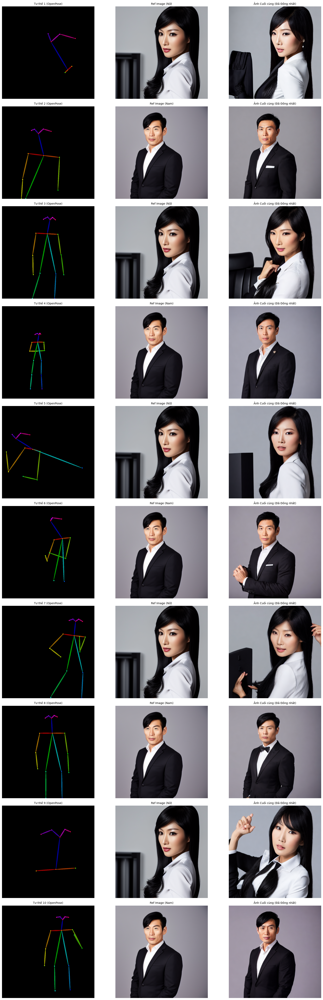

In [ ]:
# @title 3. ĐỒNG NHẤT NHÂN VẬT VÀ TẠO HÌNH ẢNH CUỐI CÙNG (POSE TRANSFER)
# !!! PHẦN NÀY ĐÃ ĐƯỢC CẬP NHẬT ĐỂ SỬ DỤNG CONTROLNET (OpenPose) VÀ IMAGE-TO-IMAGE (I2I)

import os
from PIL import Image
import torch
import matplotlib.pyplot as plt
import numpy as np # Cần để xử lý mảng axes của subplot

# *******************************************************************
# TẢI CÁC THƯ VIỆN CẦN THIẾT CHO CONTROLNET/I2I (Giả định đã cài đặt ở Cell 1)
from diffusers import StableDiffusionControlNetPipeline, ControlNetModel, StableDiffusionImg2ImgPipeline
# *******************************************************************

# --- CẤU HÌNH ---
OUTPUT_DIR = os.environ.get('OUTPUT_DIR', "Pro_Auto_Pose_Output")
CONSISTENCY_DIR = os.environ.get('CONSISTENCY_DIR', "Pro_Consistency_Output")
os.makedirs(CONSISTENCY_DIR, exist_ok=True)
device = "cuda" if torch.cuda.is_available() else "cpu"

# Lấy 2 ảnh cơ sở đã tạo để làm Reference Image cho I2I (Giả sử ảnh NU_1 và NAM_2 là tốt nhất)
try:
    REF_NU_PATH = os.path.join(OUTPUT_DIR, "NU_1_Action_Uniform_V2_base_image.png")
    REF_NAM_PATH = os.path.join(OUTPUT_DIR, "NAM_2_Action_Uniform_V2_base_image.png")

    # Đảm bảo resize ảnh tham chiếu về 768x768 (kích thước phổ biến của SD 1.5)
    REF_NU_IMAGE = Image.open(REF_NU_PATH).resize((768, 768)).convert("RGB")
    REF_NAM_IMAGE = Image.open(REF_NAM_PATH).resize((768, 768)).convert("RGB")

    print("Đã tải 2 ảnh tham chiếu thành công.")
except Exception as e:
    print(f"!!! LỖI TẢI ẢNH THAM CHIẾU: Không tìm thấy ảnh tham chiếu (NU_1 hoặc NAM_2). Lỗi: {e}")
    print("Vui lòng kiểm tra tên file và thư mục đã lưu từ Cell 2.")
    # Dùng ảnh đen tạm thời nếu không tìm thấy để tránh lỗi runtime
    REF_NU_IMAGE = Image.new('RGB', (768, 768), color = 'black')
    REF_NAM_IMAGE = Image.new('RGB', (768, 768), color = 'black')
    # Nếu không có Reference Image, quy trình I2I sẽ không hoạt động đúng

# --- KHỞI TẠO MÔ HÌNH CONTROLNET VÀ I2I PIPELINE (BƯỚC SỬA LỖI CHÍNH) ---

try:
    model_id = "runwayml/stable-diffusion-v1-5"

    # 1. Tải ControlNet Model (OpenPose)
    controlnet = ControlNetModel.from_pretrained(
        "lllyasviel/control_v11p_sd15_openpose", torch_dtype=torch.float16 if device == "cuda" else torch.float32
    ).to(device)

    # 2. Tạo Image-to-Image Pipeline và truyền ControlNet vào
    i2i_pipe = StableDiffusionImg2ImgPipeline.from_pretrained(
        model_id, torch_dtype=torch.float16 if device == "cuda" else torch.float32, controlnet=controlnet
    ).to(device)

    # Tối ưu hóa (Cần xformers được cài đặt ở Cell 1)
    if device == "cuda":
        try:
            i2i_pipe.enable_xformers_memory_efficient_attention()
            print("Đã kích hoạt tối ưu hóa xformers.")
        except Exception as e:
            print(f"CẢNH BÁO: Không thể kích hoạt xformers. Kiểm tra cài đặt. Lỗi: {e}")

    print("Đã tải ControlNet (OpenPose) và Image-to-Image Pipeline.")

except Exception as e:
    print(f"!!! LỖI KHỞI TẠO PIPELINE: {e}")
    print("Vui lòng kiểm tra lại Cell 1 đã tải mô hình Stable Diffusion và ControlNet chưa.")
    # Thiết lập i2i_pipe là None để dừng quy trình nếu có lỗi
    i2i_pipe = None

# --- DANH SÁCH CÁC CẶP FILE VÀ PROMPT CỦA CHÚNG (Không đổi) ---
PROMPT_MAP = [
    # 1. NỮ - Thách thức
    (f"NU_1_Action_Uniform_V2_openpose.png", "NU", "hands on hips, torso leaning forward aggressively, challenging body language"),
    # 2. NAM - Phòng thủ
    (f"NAM_2_Action_Uniform_V2_openpose.png", "NAM", "hands deeply set in pants pockets, shoulders slightly hunched, head tilted, defensive posture"),
    # 3. NỮ - Khước từ
    (f"NU_3_Action_Uniform_V2_openpose.png", "NU", "arms tightly crossed over chest, legs crossed, torso turned slightly away, rejecting body language"),
    # 4. NAM - Giãi bày
    (f"NAM_4_Action_Uniform_V2_openpose.png", "NAM", "both palms turned outward in a gesture of honesty, feet shoulder-width apart, pleading body posture"),
    # 5. NỮ - Đau khổ
    (f"NU_5_Action_Uniform_V2_openpose.png", "NU", "one hand clutching her chest (heart area), shoulders slumped, head slightly bowed, gesture of sudden distress"),
    # 6. NAM - Kiên quyết
    (f"NAM_6_Action_Uniform_V2_openpose.png", "NAM", "one hand clenched into a fist resting on a table, weight shifted forward, posture of firm resolve"),
    # 7. NỮ - Bối rối
    (f"NU_7_Action_Uniform_V2_openpose.png", "NU", "both hands running through her hair near temples, fingers spread, extreme confusion gesture"),
    # 8. NAM - Né tránh
    (f"NAM_8_Action_Uniform_V2_openpose.png", "NAM", "one hand covering mouth and nose, eyes darting away to the side, taking a small step back, avoiding body language"),
    # 9. NỮ - Quyết định
    (f"NU_9_Action_Uniform_V2_openpose.png", "NU", "arm extended and finger pointing directly, straight unwavering posture, decisive body language"),
    # 10. NAM - Hối lỗi
    (f"NAM_10_Action_Uniform_V2_openpose.png", "NAM", "body heavily bent forward from the waist, both arms hanging limp by his side, head lowered, gesture of despair and defeat")
]

# Style Prompt Đồng Nhất
CONSISTENCY_PROMPT_NU = "A beautiful asian woman, 30 years old, high cheekbones, long black hair, in a very tailored black business suit, clean modern studio background, high quality, full body pose, centered, cinematic lighting"
CONSISTENCY_PROMPT_NAM = "A handsome asian man, 35 years old, strong jawline, short black hair, in a very tailored black business suit, clean modern studio background, high quality, full body pose, centered, cinematic lighting"

# NEG_PROMPT: Tăng cường Negative Prompt
NEG_PROMPT = "blurry, deformed, low quality, worst quality, ugly, out of frame, cropped, cut-off, half face, upper body shot, medium shot, close up, disembodied limbs, different clothing, different hair color, two people, different face, cartoon, illustration, drawing"


final_results = []

if i2i_pipe is not None:
    print(f"\nBẮT ĐẦU ĐỒNG NHẤT VÀ TẠO LẠI 10 HÌNH ẢNH VỚI CONTROLNET...")

    for i, (pose_file, gender, pose_description) in enumerate(PROMPT_MAP):
        pose_path = os.path.join(OUTPUT_DIR, pose_file)
        output_filename = f"Final_Pose_{i+1}_{gender}"

        if not os.path.exists(pose_path):
            print(f"!!! BỎ QUA: Không tìm thấy file OpenPose: {pose_file}")
            continue

        try:
            # Lấy ảnh OpenPose đã tạo ở Cell 2 và resize
            pose_image = Image.open(pose_path).convert("RGB").resize((768, 768))

            # Chọn Reference Image và Prompt tương ứng
            if gender == "NU":
                ref_image = REF_NU_IMAGE
                final_prompt = f"{CONSISTENCY_PROMPT_NU}, {pose_description}"
            else:
                ref_image = REF_NAM_IMAGE
                final_prompt = f"{CONSISTENCY_PROMPT_NAM}, {pose_description}"

            generator = torch.Generator(device).manual_seed(100 + i)

            # --- THỰC HIỆN I2I KẾT HỢP VỚI CONTROLNET POSE (BƯỚC CONTROLNET THỰC TẾ) ---
            generated_image = i2i_pipe(
                prompt=final_prompt,
                image=ref_image,                 # Ảnh Nguồn cho I2I (ảnh tham chiếu gương mặt/style)
                control_image=pose_image,        # Ảnh ControlNet (ảnh OpenPose để chuyển tư thế)
                negative_prompt=NEG_PROMPT,
                num_inference_steps=50,          # Tăng bước inference cho chất lượng tốt hơn
                guidance_scale=9.0,
                controlnet_conditioning_scale=1.4, # Mức độ ảnh hưởng mạnh của ControlNet (tư thế)
                strength=0.9,                   # Độ mạnh I2I: 0.75 (thay đổi 75%, giữ 25% gốc)
                generator=generator
            ).images[0]
            # ----------------------------------------------------------------------

            # --- LƯU KẾT QUẢ ĐỒNG NHẤT ---
            final_output_path = os.path.join(CONSISTENCY_DIR, f"{output_filename}_FINAL_IMAGE.png")
            generated_image.save(final_output_path)

            final_results.append((final_prompt, pose_image, generated_image))
            print(f"-> Đã tạo và lưu ảnh đồng nhất cuối cùng: {final_output_path}")

        except Exception as e:
            print(f"!!! LỖI khi tạo ảnh cuối cùng cho tư thế {i+1}: {e}")
            continue

    print("\n--- HOÀN TẤT VIỆC TẠO 10 ẢNH ĐỒNG NHẤT ---")
else:
    print("\n!!! LỖI KHỞI TẠO PIPELINE. KHÔNG THỂ TIẾN HÀNH TẠO ẢNH.")


# --- HIỂN THỊ TỔNG QUAN CÁC KẾT QUẢ CUỐI CÙNG ---
num_results = len(final_results)
if num_results > 0:
    # 3 cột: Ảnh Pose (tham chiếu), Ảnh Tham chiếu I2I, Ảnh Cuối cùng Đồng nhất
    fig, axes = plt.subplots(num_results, 3, figsize=(18, 5 * num_results))

    if num_results == 1:
        # Nếu chỉ có 1 kết quả, axes không phải là mảng 2D, cần sửa lại
        axes = np.array([axes])

    print(f"\nĐang hiển thị {num_results} kết quả đồng nhất...")

    for i, (prompt, pose_img, final_img) in enumerate(final_results):
        # Cột 1: OpenPose Map (Tham chiếu tư thế)
        axes[i, 0].imshow(pose_img)
        axes[i, 0].set_title(f"Tư thế {i+1} (OpenPose)", fontsize=10)
        axes[i, 0].axis('off')

        # Cột 2: Ảnh Tham chiếu Gương mặt/Trang phục
        gender = "NU" if "asian woman" in prompt else "NAM"
        if gender == "NU":
             axes[i, 1].imshow(REF_NU_IMAGE)
             axes[i, 1].set_title(f"Ref Image (Nữ)", fontsize=10)
        else:
             axes[i, 1].imshow(REF_NAM_IMAGE)
             axes[i, 1].set_title(f"Ref Image (Nam)", fontsize=10)
        axes[i, 1].axis('off')

        # Cột 3: Ảnh Cuối cùng (Đã Đồng nhất)
        axes[i, 2].imshow(final_img)
        axes[i, 2].set_title(f"Ảnh Cuối cùng (Đã Đồng nhất)", fontsize=10)
        axes[i, 2].axis('off')

    plt.tight_layout()
    plt.show()
else:
    print("Không có kết quả nào được tạo ra.")


In [ ]:
# @title 5. CHUẨN BỊ ẢNH NỀN CỐ ĐỊNH VÀ TRÍCH XUẤT DEPTH MAP (Bối cảnh Đồng nhất)

import os
from PIL import Image
import torch
import numpy as np
# Cần các thư viện đã được tải ở Cell 1
from controlnet_aux import DepthEstimator

# --- CẤU HÌNH ---
OUTPUT_DIR = os.environ.get('OUTPUT_DIR', "Pro_Auto_Pose_Output")
device = "cuda" if torch.cuda.is_available() else "cpu"

# --- KHỞI TẠO PREPROCESSOR (Giả định đã có từ Cell 1) ---
try:
    # Tải lại Depth Estimator nếu biến 'depth_detector' không còn tồn tại
    # Trong môi trường Colab, đôi khi biến có thể bị mất giữa các cell.
    if 'depth_detector' not in locals():
        depth_detector = DepthEstimator.from_pretrained("Intel/dpt-large").to(device)
        print("Đã tải lại mô hình Depth Detector.")
except Exception as e:
    print(f"!!! LỖI KHỞI TẠO DEPTH DETECTOR: {e}")
    print("Vui lòng đảm bảo Cell 1 đã chạy các lệnh cài đặt và tải mô hình.")
    depth_detector = None


# --- ĐỊNH NGHĨA VÀ TẢI ẢNH NỀN ---
# !!! CHỈ ĐỊNH ĐƯỜNG DẪN ĐẾN ẢNH NỀN MÀ BẠN ĐÃ TẢI LÊN !!!
REF_BACKGROUND_FILENAME = "fixed_office_background.png"
# Hoặc thay bằng đường dẫn thực tế của bạn
REF_BACKGROUND_PATH = os.path.join(os.getcwd(), REF_BACKGROUND_FILENAME)

BG_IMAGE = None
BG_DEPTH_MAP = None

if os.path.exists(REF_BACKGROUND_PATH) and depth_detector is not None:
    try:
        # Tải ảnh, resize về kích thước Stable Diffusion (768x768)
        BG_IMAGE = Image.open(REF_BACKGROUND_PATH).resize((768, 768)).convert("RGB")
        print(f"Đã tải ảnh nền cố định: {REF_BACKGROUND_FILENAME}")

        # --- TRÍCH XUẤT DEPTH MAP (CONTROL MAP THỨ HAI) ---
        # Depth Map sẽ khóa cấu trúc 3D của bối cảnh
        BG_DEPTH_MAP = depth_detector(BG_IMAGE)
        print("Đã tạo Depth Map cho bối cảnh cố định thành công.")

        # --- HIỂN THỊ KẾT QUẢ TRÍCH XUẤT ---
        fig, axes = plt.subplots(1, 2, figsize=(12, 6))

        axes[0].imshow(BG_IMAGE)
        axes[0].set_title("1. Ảnh Nền Gốc (Reference Background)", fontsize=10)
        axes[0].axis('off')

        axes[1].imshow(BG_DEPTH_MAP, cmap='gray') # Depth Map thường hiển thị tốt hơn với cmap='gray'
        axes[1].set_title("2. Depth Map (Control Map cho Bối cảnh)", fontsize=10)
        axes[1].axis('off')

        plt.tight_layout()
        plt.show()

    except Exception as e:
        print(f"!!! LỖI XỬ LÝ ẢNH NỀN/DEPTH MAP: {e}")
else:
    print(f"!!! KHÔNG TÌM THẤY ẢNH NỀN TẠI: {REF_BACKGROUND_PATH}")
    print("Vui lòng tải ảnh nền và đặt tên file là 'fixed_office_background.png' hoặc sửa đường dẫn trong code.")

# --- ĐẶT BIẾN TOÀN CỤC CHO CELL 3 ---
# Các biến này sẽ được Cell 3 sử dụng
if BG_DEPTH_MAP:
    globals()['BG_DEPTH_MAP'] = BG_DEPTH_MAP
    globals()['BG_IMAGE'] = BG_IMAGE # Lưu lại ảnh gốc để hiển thị trong Cell 3 nếu cần

print("\n--- HOÀN TẤT CELL 5: SẴN SÀNG CHO DUAL CONTROLNET TRONG CELL 3 ---")


In [ ]:
# @title 1. CẤU HÌNH CÁC THAM SỐ VÀ DANH SÁCH TƯ THẾ

import os
import torch

# --- 1. THÔNG SỐ ĐẦU RA ---
OUTPUT_DIR = os.environ.get('OUTPUT_DIR', "Pro_Auto_Pose_Output")
os.makedirs(OUTPUT_DIR, exist_ok=True)
device = "cuda" if torch.cuda.is_available() else "cpu"

# --- 2. THAM SỐ STABLE DIFFUSION VÀ MÔ HÌNH ---
NUM_INFERENCE_STEPS = 25
GUIDANCE_SCALE = 9.0
DETECT_RESOLUTION = 768
IMAGE_RESOLUTION = 768

# --- 3. PROMPT GỐC (ĐỒNG NHẤT NHÂN VẬT VÀ BỐI CẢNH) ---
WOMAN_REF = "A beautiful asian woman, 30 years old, high cheekbones, long black hair, in a very tailored black business suit, sharp focus"
MAN_REF = "A handsome asian man, 35 years old, strong jawline, short black hair, in a very tailored black business suit, sharp focus"
SCENE = "in a clean, minimal studio, cinematic lighting, focused on the subject, plain white floor"

# --- 4. DANH SÁCH TƯ THẾ, SEED VÀ GIỚI TÍNH ---
# Cấu trúc: (Giới tính, Seed Bắt Đầu, Mô tả Tư thế)
# Seed sẽ là: Seed Bắt Đầu + Index (ví dụ: NU_1 là 1000+0, NAM_2 là 2000+1)
POSE_CONFIGS = [
    ("NU", 1000, "hands on hips, torso leaning forward aggressively, challenging body language"),
    ("NAM", 2000, "hands deeply set in pants pockets, shoulders slightly hunched, head tilted, defensive posture"),
    ("NU", 1000, "arms tightly crossed over chest, legs crossed, torso turned slightly away, rejecting body language"),
    ("NAM", 2000, "both palms turned outward in a gesture of honesty, feet shoulder-width apart, pleading body posture"),
    ("NU", 1000, "one hand clutching her chest (heart area), shoulders slumped, head slightly bowed, gesture of sudden distress"),
    ("NAM", 2000, "one hand clenched into a fist resting on a table, weight shifted forward, posture of firm resolve"),
    ("NU", 1000, "both hands running through her hair near temples, fingers spread, extreme confusion gesture"),
    ("NAM", 2000, "one hand covering mouth and nose, eyes darting away to the side, taking a small step back, avoiding body language"),
    ("NU", 1000, "arm extended and finger pointing directly, straight unwavering posture, decisive body language"),
    ("NAM", 2000, "body heavily bent forward from the waist, both arms hanging limp by his side, head lowered, gesture of despair and defeat")
]

# --- 5. NEGATIVE PROMPT ---
NEG_PROMPT = "blurry, deformed, low quality, worst quality, extra limbs, ugly, out of frame, cropped, cut-off, zoomed-in, half body, half face, upper body shot, medium shot, close up, partial figure, disembodied limbs, low contrast, messy clothes, one person, single subject, different clothing, different hair color"

print("--- CẤU HÌNH HOÀN TẤT. Sẵn sàng chạy Cell xử lý. ---")


--- CẤU HÌNH HOÀN TẤT. Sẵn sàng chạy Cell xử lý. ---


In [ ]:
# @title KỊCH BẢN 1: CHUYÊN NGHIỆP VÀ LẠNH LÙNG (Business/Studio) - Ghi đè Cấu hình

import os
import torch

# --- 1. THÔNG SỐ CỐ ĐỊNH (Ghi đè) ---
# Dùng tên thư mục đầu ra mới cho dễ quản lý
OUTPUT_DIR = os.environ.get('OUTPUT_DIR', "Output_KichBan_1_Business")
os.makedirs(OUTPUT_DIR, exist_ok=True)
device = "cuda" if torch.cuda.is_available() else "cpu"
NUM_INFERENCE_STEPS = 25
GUIDANCE_SCALE = 9.0
DETECT_RESOLUTION = 768
IMAGE_RESOLUTION = 768

# --- 2. PROMPT GỐC (Ghi đè) ---
# TRANG PHỤC: Business Suit | ÁNH SÁNG: Lạnh
WOMAN_REF = "A beautiful asian woman, 30 years old, high cheekbones, long straight black hair, wearing a very tailored black business suit, sharp focus"
MAN_REF = "A handsome asian man, 35 years old, strong jawline, short black hair, wearing a very tailored black business suit, sharp focus"
SCENE = "in a pristine white studio, strong blue cinematic lighting, cold atmosphere, plain white floor, full body pose, centered"

# --- 3. DANH SÁCH TƯ THẾ, SEED VÀ CẢNH (Ghi đè) ---
POSE_CONFIGS = [
    ("NU", 10000, "hands on hips, chin slightly up, cold and dominant expression, posture of authority"),
    ("NAM", 10000, "arms crossed, shoulders back, intense eye contact, expression of firm resolution"),
    ("NU", 10000, "hand touching her jawline, head tilted, posture of deep skepticism and questioning"),
    ("NAM", 10000, "torso leaning forward, one hand flat on an unseen table, posture of impatience and readiness to argue"),
]

# --- 4. NEGATIVE PROMPT (Ghi đè) ---
NEG_PROMPT = "blurry, deformed, warm lighting, soft light, cozy, smiling, low quality, worst quality, extra limbs, ugly, out of frame, different clothing, different hair color"

print("--- ĐÃ CẤU HÌNH KỊCH BẢN 1 (CHUYÊN NGHIỆP). Sẵn sàng chạy Cell xử lý. ---")


--- ĐÃ CẤU HÌNH KỊCH BẢN 1 (CHUYÊN NGHIỆP). Sẵn sàng chạy Cell xử lý. ---


In [ ]:
# @title KỊCH BẢN 2: LÃNG MẠN VÀ THƯ GIÃN (Casual/Thiên nhiên) - Ghi đè Cấu hình

import os
import torch

# --- 1. THÔNG SỐ CỐ ĐỊNH (Ghi đè) ---
OUTPUT_DIR = os.environ.get('OUTPUT_DIR', "Output_KichBan_2_Romantic")
os.makedirs(OUTPUT_DIR, exist_ok=True)
device = "cuda" if torch.cuda.is_available() else "cpu"
NUM_INFERENCE_STEPS = 25
GUIDANCE_SCALE = 9.0
DETECT_RESOLUTION = 768
IMAGE_RESOLUTION = 768

# --- 2. PROMPT GỐC (Ghi đè) ---
# TRANG PHỤC: Casual | ÁNH SÁNG: Ấm
WOMAN_REF = "A beautiful asian woman, 30 years old, high cheekbones, long wavy black hair, wearing a white oversized linen shirt and jeans, soft focus"
MAN_REF = "A handsome asian man, 35 years old, strong jawline, messy black hair, wearing a navy blue casual blazer and khaki pants, soft focus"
SCENE = "in a peaceful forest clearing, golden hour sunset light, cinematic bokeh, lush green background, full body pose, centered"

# --- 3. DANH SÁCH TƯ THẾ, SEED VÀ CẢNH (Ghi đè) ---
POSE_CONFIGS = [
    ("NU", 20000, "standing relaxed, one hand brushing back hair, looking at the distance with a gentle smile, posture of calm happiness"),
    ("NAM", 20000, "leaning against an unseen tree, hands clasped behind head, eyes closed, expression of deep contentment"),
    ("NU", 20000, "hands cupped over her mouth, head tilted back, expression of surprise and genuine laughter"),
    ("NAM", 20000, "standing straight, one hand holding the woman's hand (hãy tưởng tượng), looking at her with an affectionate gaze"),
]

# --- 4. NEGATIVE PROMPT (Ghi đè) ---
NEG_PROMPT = "blurry, deformed, studio light, business suit, low quality, worst quality, extra limbs, ugly, out of frame, cold atmosphere, different clothing, different hair color"

print("--- ĐÃ CẤU HÌNH KỊCH BẢN 2 (LÃNG MẠN/CASUAL). Sẵn sàng chạy Cell xử lý. ---")


--- ĐÃ CẤU HÌNH KỊCH BẢN 2 (LÃNG MẠN/CASUAL). Sẵn sàng chạy Cell xử lý. ---


In [10]:
# @title KỊCH BẢN 3: NĂNG ĐỘNG VÀ BỨT PHÁ (Sportswear/Đô thị) - Ghi đè Cấu hình

import os
import torch

# --- 1. THÔNG SỐ CỐ ĐỊNH (Ghi đè) ---
OUTPUT_DIR = os.environ.get('OUTPUT_DIR', "Output_KichBan_3_Dynamic")
os.makedirs(OUTPUT_DIR, exist_ok=True)
device = "cuda" if torch.cuda.is_available() else "cpu"
NUM_INFERENCE_STEPS = 25
GUIDANCE_SCALE = 9.0
DETECT_RESOLUTION = 768
IMAGE_RESOLUTION = 768

# --- 2. PROMPT GỐC (Ghi đè) ---
# TRANG PHỤC: Thể thao | ÁNH SÁNG: Gay gắt/Ban ngày
WOMAN_REF = "A beautiful asian woman, 30 years old, tied back black ponytail, wearing black athleisure leggings and a matching sports top, sharp focus"
MAN_REF = "A handsome asian man, 35 years old, short spiky black hair, wearing a tight black athletic t-shirt and running shorts, sharp focus"
SCENE = "on a rooftop in a modern city, harsh midday sun lighting, strong shadows, blurred city background, full body pose, centered"

# --- 3. DANH SÁCH TƯ THẾ, SEED VÀ CẢNH (Ghi đè) ---
POSE_CONFIGS = [
    ("NU", 30000, "one leg bent, hands on knees, slightly out of breath, expression of exertion after a long run"),
    ("NAM", 30000, "arms raised in a victory V-sign, head slightly back, expression of pure triumph and excitement"),
    ("NU", 30000, "standing in a dynamic martial arts stance, fist clenched, eyes sharp, ready to move"),
    ("NAM", 30000, "body twisted, looking back over shoulder, one arm stretched forward, gesture of momentum and speed"),
]

# --- 4. NEGATIVE PROMPT (Ghi đè) ---
NEG_PROMPT = "blurry, deformed, business suit, soft lighting, cozy, low quality, worst quality, extra limbs, ugly, out of frame, different clothing, different hair color"

print("--- ĐÃ CẤU HÌNH KỊCH BẢN 3 (NĂNG ĐỘNG). Sẵn sàng chạy Cell xử lý. ---")


--- ĐÃ CẤU HÌNH KỊCH BẢN 3 (NĂNG ĐỘNG). Sẵn sàng chạy Cell xử lý. ---


In [ ]:
# @title KỊCH BẢN 4: BÍ ẨN VÀ NGHỆ THUẬT (Artistic & Mysterious) - Ghi đè Cấu hình

import os
import torch

# --- 1. THÔNG SỐ CỐ ĐỊNH (Ghi đè) ---
# Dùng tên thư mục đầu ra mới cho dễ quản lý
OUTPUT_DIR = os.environ.get('OUTPUT_DIR', "Output_KichBan_4_Mysterious")
os.makedirs(OUTPUT_DIR, exist_ok=True)
device = "cuda" if torch.cuda.is_available() else "cpu"
NUM_INFERENCE_STEPS = 25
GUIDANCE_SCALE = 9.0
DETECT_RESOLUTION = 768
IMAGE_RESOLUTION = 768

# --- 2. PROMPT GỐC (Ghi đè) ---
# TRANG PHỤC: Nghệ thuật/Tối giản | ÁNH SÁNG: Kịch tính
WOMAN_REF = "A beautiful asian woman, 30 years old, high cheekbones, long flowing black hair, wearing a loose black turtleneck sweater, dramatic chiaroscuro lighting"
MAN_REF = "A handsome asian man, 35 years old, strong jawline, slicked back black hair, wearing a high-collared black leather jacket, dramatic chiaroscuro lighting"
SCENE = "in a dark, moody apartment corner, single strong window light creating deep shadows, high contrast, minimalist setting, full body pose, centered"

# --- 3. DANH SÁCH TƯ THẾ, SEED VÀ CẢNH (Ghi đè) ---
# SEED BASE cho Kịch bản 4: Bắt đầu từ 40000
POSE_CONFIGS = [
    ("NU", 40000, "standing in profile, arms tightly wrapped around her body, head slightly bowed, gesture of self-protection or solitude"), # Cô đơn/Tự bảo vệ
    ("NAM", 40000, "one hand covering one eye, face partially hidden in shadow, posture of deep skepticism and questioning reality"), # Hoài nghi/Che giấu
    ("NU", 40000, "kneeling gently on the floor, arms extended forward with open palms, looking up intensely, gesture of supplication or yearning"), # Khao khát
    ("NAM", 40000, "seated on an unseen stool, leaning forward, chin resting on clasped hands, posture of deep philosophical contemplation"), # Trầm tư/Triết lý
]

# --- 4. NEGATIVE PROMPT (Ghi đè) ---
NEG_PROMPT = "blurry, deformed, bright light, happy, smiling, business suit, low quality, worst quality, extra limbs, ugly, out of frame, different clothing, different hair color"

print("--- ĐÃ CẤU HÌNH KỊCH BẢN 4 (BÍ ẨN/NGHỆ THUẬT). Sẵn sàng chạy Cell xử lý. ---")


--- ĐÃ CẤU HÌNH KỊCH BẢN 4 (BÍ ẨN/NGHỆ THUẬT). Sẵn sàng chạy Cell xử lý. ---


The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['light creating deep shadows , high contrast , minimalist setting , full body pose , centered']


BẮT ĐẦU TẠO VÀ HIỂN THỊ 4 OPENPOSE MAPS...

--- Xử lý NU_1 (Seed: 40000): standing in profile, arms tightly wrapped around h...


  0%|          | 0/25 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['light creating deep shadows , high contrast , minimalist setting , full body pose , centered']


-> Đã lưu OpenPose và Base Image tại Pro_Auto_Pose_Output

--- Xử lý NAM_2 (Seed: 40001): one hand covering one eye, face partially hidden i...


  0%|          | 0/25 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['corner , single strong window light creating deep shadows , high contrast , minimalist setting , full body pose , centered']


-> Đã lưu OpenPose và Base Image tại Pro_Auto_Pose_Output

--- Xử lý NU_3 (Seed: 40002): kneeling gently on the floor, arms extended forwar...


  0%|          | 0/25 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['strong window light creating deep shadows , high contrast , minimalist setting , full body pose , centered']


-> Đã lưu OpenPose và Base Image tại Pro_Auto_Pose_Output

--- Xử lý NAM_4 (Seed: 40003): seated on an unseen stool, leaning forward, chin r...


  0%|          | 0/25 [00:00<?, ?it/s]

-> Đã lưu OpenPose và Base Image tại Pro_Auto_Pose_Output

--- HOÀN TẤT VÒNG LẶP TẠO VÀ LƯU OPENPOSE MAPS. ---
Đang hiển thị 4 cặp ảnh: Ảnh Cơ sở và OpenPose Map...


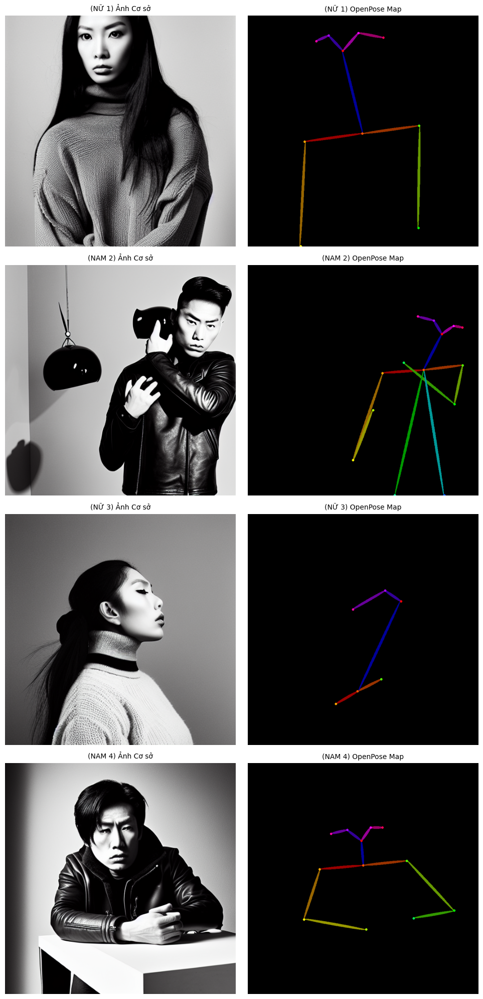

In [ ]:
# @title 2. VÒNG LẶP XỬ LÝ: TẠO VÀ HIỂN THỊ OPENPOSE MAPS

import os
import torch
from PIL import Image
import matplotlib.pyplot as plt
import numpy as np # Cần numpy để xử lý mảng matplotlib

# Kiểm tra các biến cốt lõi
if 'POSE_CONFIGS' not in globals() or 'pipe' not in globals() or 'openpose_detector' not in globals():
    print("!!! LỖI: Vui lòng chạy Cell Cấu hình (Cell 1) và đảm bảo 'pipe' và 'openpose_detector' đã được khởi tạo.")
    raise Exception("Thiếu biến cấu hình hoặc Pipeline.")

print(f"BẮT ĐẦU TẠO VÀ HIỂN THỊ {len(POSE_CONFIGS)} OPENPOSE MAPS...")

# Danh sách để lưu kết quả hiển thị cuối cùng (để hiển thị tổng quan)
results_for_display = []

for i, (gender_prefix, base_seed, pose_description) in enumerate(POSE_CONFIGS):
    pose_index = i + 1

    # Tính toán Seed và Prompt cuối cùng
    current_seed = base_seed + i

    if gender_prefix == "NU":
        base_ref = WOMAN_REF
    else:
        base_ref = MAN_REF

    final_prompt = f"{base_ref}, {pose_description}, full body pose, centered, {SCENE}"
    generator = torch.Generator(device).manual_seed(current_seed)

    print(f"\n--- Xử lý {gender_prefix}_{pose_index} (Seed: {current_seed}): {pose_description[:50]}...")

    try:
        # 1. Tạo ảnh cơ sở (Text-to-Image)
        base_image = pipe(
            final_prompt,
            negative_prompt=NEG_PROMPT,
            num_inference_steps=NUM_INFERENCE_STEPS,
            guidance_scale=GUIDANCE_SCALE,
            generator=generator
        ).images[0]

        # 2. Trích xuất Pose
        pose_image = openpose_detector(base_image, detect_resolution=DETECT_RESOLUTION, image_resolution=IMAGE_RESOLUTION)

        output_filename = f"{gender_prefix}_{pose_index}_Action_Uniform_V2"

        # 3. Lưu ảnh BASE và OpenPose Map
        base_output_path = os.path.join(OUTPUT_DIR, f"{output_filename}_base_image.png")
        pose_output_path = os.path.join(OUTPUT_DIR, f"{output_filename}_openpose.png")

        base_image.save(base_output_path)
        pose_image.save(pose_output_path)

        # Cố định ảnh tham chiếu tốt nhất cho Cell tiếp theo (NU_1 và NAM_2)
        if pose_index == 1 and gender_prefix == "NU":
             globals()['REF_NU_IMAGE'] = base_image
        if pose_index == 2 and gender_prefix == "NAM":
             globals()['REF_NAM_IMAGE'] = base_image

        print(f"-> Đã lưu OpenPose và Base Image tại {OUTPUT_DIR}")

        # Thêm kết quả vào danh sách hiển thị
        results_for_display.append((gender_prefix, pose_index, base_image, pose_image))

    except Exception as e:
        print(f"!!! LỖI khi tạo tư thế {gender_prefix}_{pose_index}: {e}")
        continue

print("\n--- HOÀN TẤT VÒNG LẶP TẠO VÀ LƯU OPENPOSE MAPS. ---")

# --- HIỂN THỊ TỔNG QUAN CÁC KẾT QUẢ CUỐI CÙNG ---
num_results = len(results_for_display)
if num_results > 0:
    fig, axes = plt.subplots(num_results, 2, figsize=(10, 5 * num_results))

    # Đảm bảo axes là mảng 2 chiều ngay cả khi chỉ có 1 kết quả
    if num_results == 1:
        axes = np.array([axes])

    print(f"Đang hiển thị {num_results} cặp ảnh: Ảnh Cơ sở và OpenPose Map...")

    for i, (gender, index, base_img, pose_img) in enumerate(results_for_display):
        title_prefix = "NỮ" if gender == "NU" else "NAM"

        # Cột 1: Hiển thị ảnh cơ sở (Base Image)
        axes[i, 0].imshow(base_img)
        axes[i, 0].set_title(f"({title_prefix} {index}) Ảnh Cơ sở", fontsize=10)
        axes[i, 0].axis('off')

        # Cột 2: Hiển thị ảnh OpenPose
        axes[i, 1].imshow(pose_img)
        axes[i, 1].set_title(f"({title_prefix} {index}) OpenPose Map", fontsize=10)
        axes[i, 1].axis('off')

    plt.tight_layout()
    plt.show()
else:
    print("Không có kết quả nào được tạo ra để hiển thị.")


In [11]:
import torch
import gc

# 1. XÓA PIPELINE VÀ MÔ HÌNH KHỎI BỘ NHỚ VRAM
print("Bắt đầu giải phóng VRAM và RAM...")

# Vô hiệu hóa tính năng tự động tính toán gradient (giúp giảm bộ nhớ)
torch.cuda.empty_cache()

# Xóa pipeline khỏi VRAM và sau đó xóa biến
if 'i2i_pipe' in locals() and i2i_pipe is not None:
    # Di chuyển mô hình khỏi GPU (chuyển sang RAM hoặc xóa hẳn)
    del i2i_pipe

# Xóa ControlNet khỏi VRAM và sau đó xóa biến
if 'controlnet' in locals() and controlnet is not None:
    del controlnet

# Xóa các biến Generator và Image (nếu chúng còn trong bộ nhớ)
if 'generator' in locals():
    del generator
if 'generated_image' in locals():
    del generated_image
if 'ref_image' in locals():
    del ref_image
if 'pose_image' in locals():
    del pose_image

# 2. Thu gom rác của Python (Giải phóng RAM)
gc.collect()

# 3. Giải phóng Bộ nhớ đệm của GPU (VRAM)
# Lệnh này là quan trọng nhất để giải phóng bộ nhớ bị fragment
if torch.cuda.is_available():
    torch.cuda.empty_cache()
    print(f"✅ Đã giải phóng VRAM. Tổng bộ nhớ VRAM hiện tại đang dùng: {torch.cuda.memory_allocated() / (1024**3):.2f} GB")
else:
    print("✅ Đã hoàn tất dọn dẹp RAM (Không tìm thấy GPU).")

Bắt đầu giải phóng VRAM và RAM...
✅ Đã giải phóng VRAM. Tổng bộ nhớ VRAM hiện tại đang dùng: 2.58 GB


In [2]:
import os
from PIL import Image
import torch
# Tải các thư viện Diffusers cần thiết
from diffusers import StableDiffusionControlNetPipeline, ControlNetModel, StableDiffusionImg2ImgPipeline
import numpy as np # Thêm thư viện numpy nếu muốn dùng cho hiển thị

# --- CẤU HÌNH VÀ KHỞI TẠO ---
device = "cuda" if torch.cuda.is_available() else "cpu"
OUTPUT_DIR = "Pro_Auto_Pose_Output"
CONSISTENCY_DIR = "Pro_Consistency_Output"
os.makedirs(CONSISTENCY_DIR, exist_ok=True)
TARGET_SIZE = (768, 768)

# 1. TẢI VÀ KHỞI TẠO CÁC MÔ HÌNH
try:
    model_id = "runwayml/stable-diffusion-v1-5" # Hoặc sử dụng SDXL nếu cần

    # Tải ControlNet Model (OpenPose)
    controlnet = ControlNetModel.from_pretrained(
        "lllyasviel/control_v11p_sd15_openpose", torch_dtype=torch.float16 if device == "cuda" else torch.float32
    ).to(device)

    # Tạo Image-to-Image Pipeline và truyền ControlNet vào
    i2i_pipe = StableDiffusionImg2ImgPipeline.from_pretrained(
        model_id, torch_dtype=torch.float16 if device == "cuda" else torch.float32, controlnet=controlnet
    ).to(device)

    # Tối ưu hóa (Nếu xformers đã được cài đặt)
    if device == "cuda":
         i2i_pipe.enable_xformers_memory_efficient_attention()

    print("✅ Đã tải ControlNet (OpenPose) và Image-to-Image Pipeline thành công.")
except Exception as e:
    print(f"❌ LỖI KHỞI TẠO PIPELINE: {e}")
    i2i_pipe = None

Keyword arguments {'controlnet': ControlNetModel(
  (conv_in): Conv2d(4, 320, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (time_proj): Timesteps()
  (time_embedding): TimestepEmbedding(
    (linear_1): Linear(in_features=320, out_features=1280, bias=True)
    (act): SiLU()
    (linear_2): Linear(in_features=1280, out_features=1280, bias=True)
  )
  (controlnet_cond_embedding): ControlNetConditioningEmbedding(
    (conv_in): Conv2d(3, 16, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (blocks): ModuleList(
      (0): Conv2d(16, 16, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (1): Conv2d(16, 32, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
      (2): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (3): Conv2d(32, 96, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
      (4): Conv2d(96, 96, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (5): Conv2d(96, 256, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
    )
   

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

✅ Đã tải ControlNet (OpenPose) và Image-to-Image Pipeline thành công.


In [5]:
!pip install xformers

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 117.2/117.2 MB 5.4 MB/s eta 0:00:00


In [3]:
# --- CELL 0: TẢI ẢNH, TẠO OPENPOSE VÀ CẤU HÌNH ĐƯỜNG DẪN ---

import os
from PIL import Image

# Cài đặt thư viện cần thiết (OpenPose Preprocessor)
try:
    from google.colab import files
    from controlnet_aux import OpenposeDetector
except ImportError:
    print("Cài đặt controlnet_aux...")
    !pip install controlnet_aux
    from google.colab import files
    from controlnet_aux import OpenposeDetector

# --- CẤU HÌNH BIẾN CHUNG ---
OUTPUT_DIR = "Pro_Auto_Pose_Output"
CONSISTENCY_DIR = "Pro_Consistency_Output"
TARGET_SIZE = (768, 768)
POSE_FILE = "generated_openpose_map.png"
OUTPUT_FILENAME = "Final_Improved_Image"

os.makedirs(OUTPUT_DIR, exist_ok=True)
os.makedirs(CONSISTENCY_DIR, exist_ok=True)


# 1. TẢI ẢNH GỐC (Ảnh 80% bạn muốn sửa)
print("VUI LÒNG CHỌN ẢNH GỐC (80%) TỪ MÁY TÍNH CỦA BẠN:")
REF_FILE_NAME = None
try:
    uploaded = files.upload()
    REF_FILE_NAME_UPLOADED = next(iter(uploaded))

    # Đặt tên file đầu ra nhất quán
    REF_FILE_NAME = "uploaded_ref_image.png"
    os.rename(REF_FILE_NAME_UPLOADED, REF_FILE_NAME)

except Exception as e:
    print(f"❌ LỖI KHI TẢI ẢNH GỐC: {e}. Vui lòng kiểm tra môi trường.")
    exit() # Dừng nếu không tải được ảnh


# 2. KHỞI TẠO VÀ TẠO OPENPOSE MAP TỪ ẢNH GỐC
try:
    # Tải ảnh gốc
    base_image = Image.open(REF_FILE_NAME).convert("RGB")

    # TẠO KHUNG XƯƠNG OPENPOSE TỪ ẢNH GỐC
    pose_image = openpose_detector(base_image, detect_resolution=512, image_resolution=512)

    # Khai báo đường dẫn đầy đủ đến ảnh OpenPose SẼ ĐƯỢC TẠO
    POSE_PATH = os.path.join(OUTPUT_DIR, POSE_FILE)

    # Lưu ảnh OpenPose
    pose_image.save(POSE_PATH)

    print(f"\n✅ Đã tạo ảnh OpenPose Map thành công và lưu tại: {POSE_PATH}")

except Exception as e:
    print(f"❌ LỖI KHI TẠO OPENPOSE MAP: {e}")
    exit()


# --- 3. KHAI BÁO CÁC BIẾN CUỐI CÙNG CHO CÁC CELL KHÁC ---

REF_IMAGE_PATH = REF_FILE_NAME

print("\n--- CẤU HÌNH HOÀN TẤT ---")
print(f"Ảnh Gốc (80%) được đặt tên: {REF_IMAGE_PATH}")
print(f"Ảnh OpenPose được tạo và lưu tại: {POSE_PATH}")

VUI LÒNG CHỌN ẢNH GỐC (80%) TỪ MÁY TÍNH CỦA BẠN:


Saving c4.jpg to c4 (1).jpg

✅ Đã tạo ảnh OpenPose Map thành công và lưu tại: Pro_Auto_Pose_Output/generated_openpose_map.png

--- CẤU HÌNH HOÀN TẤT ---
Ảnh Gốc (80%) được đặt tên: uploaded_ref_image.png
Ảnh OpenPose được tạo và lưu tại: Pro_Auto_Pose_Output/generated_openpose_map.png



BẮT ĐẦU CHUYỂN ĐỔI (Strength: 0.7, ControlNet: 1.8)...


  0%|          | 0/52 [00:00<?, ?it/s]

✅ HOÀN TẤT. Ảnh đã lưu tại: Pro_Consistency_Output/Final_Improved_Image_FINAL_IMAGE.png


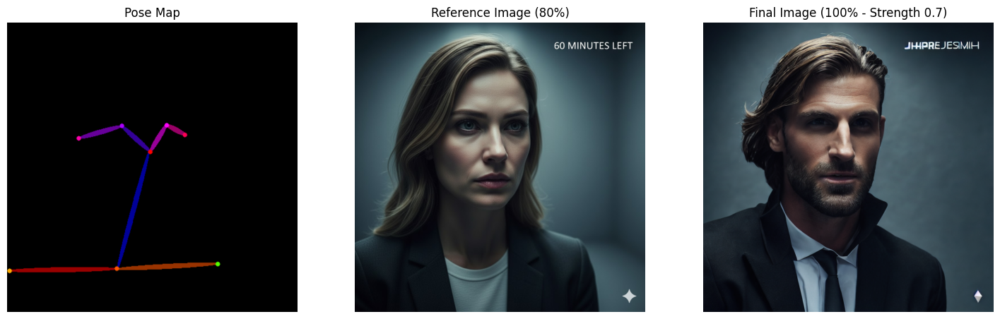

In [10]:

FINAL_PROMPT = "A handsome 30 year old Caucasian man, sharp jawline, short brown hair, muscular physique, wearing the exact same black business suit, clean modern studio background, high quality, full body pose, centered, cinematic lighting"

NEG_PROMPT = "blurry, deformed, low quality, worst quality, ugly, out of frame, cropped, cut-off, half face, upper body shot, medium shot, close up, disembodied limbs, different clothing, different hair color, two people, different face, cartoon, illustration, drawing, asian woman, long black hair, high cheekbones"

    # --- THAM SỐ ĐIỀU CHỈNH ĐỂ THAY ĐỔI NHÂN VẬT NHƯNG GIỮ BỐ CỤC ---
    # STRENGTH: Cho phép thay đổi nhân vật (khuôn mặt, vóc dáng) nhưng cố gắng giữ lại trang phục và background.
STRENGTH_I2I = 0.70           # ĐIỀU CHỈNH: Từ 0.90 xuống 0.70 (Giữ 30% cấu trúc gốc, thay đổi nhân vật)

    # CONTROLNET_SCALE: Rất mạnh để giữ tư thế của ảnh gốc (vì pose_image là từ ảnh gốc)
CONTROLNET_SCALE = 1.8        # ĐIỀU CHỈNH: Tăng cường để ControlNet ép tư thế y hệt ảnh gốc

INFERENCE_STEPS = 75


# Yêu cầu: Đã chạy Cell 1 thành công
if i2i_pipe is None:
    print("❌ LỖI: Pipeline chưa được khởi tạo. Vui lòng chạy Cell 1.")
else:

    OUTPUT_FILENAME = "Final_Improved_Image"








    # --- TẢI ẢNH VÀ THỰC THI ---
    try:
        ref_image = Image.open(REF_IMAGE_PATH).resize(TARGET_SIZE).convert("RGB")
        pose_image = Image.open(POSE_PATH).convert("RGB").resize(TARGET_SIZE)
        generator = torch.Generator(device).manual_seed(43)

        print(f"\nBẮT ĐẦU CHUYỂN ĐỔI (Strength: {STRENGTH_I2I}, ControlNet: {CONTROLNET_SCALE})...")

        # --- THỰC HIỆN CHUYỂN ĐỔI ---
        generated_image = i2i_pipe(
            prompt=FINAL_PROMPT,
            image=ref_image,                 # Ảnh Gốc (80% ID)
            control_image=pose_image,        # Tư thế mới
            negative_prompt=NEG_PROMPT,
            num_inference_steps=INFERENCE_STEPS,
            guidance_scale=9.0,
            controlnet_conditioning_scale=CONTROLNET_SCALE,
            strength=STRENGTH_I2I,           # Sửa lỗi và áp dụng style/tư thế
            generator=generator
        ).images[0]
        # ---------------------------

        # --- LƯU KẾT QUẢ ---
        final_output_path = os.path.join(CONSISTENCY_DIR, f"{OUTPUT_FILENAME}_FINAL_IMAGE.png")
        generated_image.save(final_output_path)
        print(f"✅ HOÀN TẤT. Ảnh đã lưu tại: {final_output_path}")

        # --- HIỂN THỊ KẾT QUẢ (Nếu chạy trong môi trường có thể hiển thị ảnh) ---
        import matplotlib.pyplot as plt
        fig, axes = plt.subplots(1, 3, figsize=(18, 6))
        axes[0].imshow(pose_image); axes[0].set_title("Pose Map"); axes[0].axis('off')
        axes[1].imshow(ref_image); axes[1].set_title(f"Reference Image (80%)"); axes[1].axis('off')
        axes[2].imshow(generated_image); axes[2].set_title(f"Final Image (100% - Strength {STRENGTH_I2I})"); axes[2].axis('off')
        plt.show()

    except FileNotFoundError:
        print("❌ LỖI FILE: Không tìm thấy ảnh. Vui lòng kiểm tra lại REF_IMAGE_PATH và POSE_PATH.")
    except Exception as e:
        print(f"❌ LỖI KHI TẠO ẢNH: {e}")